In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
!pip install shap

Defaulting to user installation because normal site-packages is not writeable


In [3]:
!pip install tensorflow
!pip install keras
!pip install matplotlib

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [4]:
from datetime import datetime as dt
import matplotlib.pyplot as plt
from itertools import cycle
import numpy as np
import pandas as pd
import shap
from sklearn.metrics import classification_report
from scipy import signal
import keras 
from tensorflow.keras.models import Sequential 
#from keras.utils import to_categorical
from tensorflow.keras.utils import to_categorical
from keras.layers import Activation, Dense
from sklearn.model_selection import train_test_split
import tensorflow.compat.v1.keras.backend as K
import tensorflow as tf
from sklearn.metrics import roc_curve, auc ,roc_auc_score
tf.compat.v1.disable_eager_execution()
tf.compat.v1.disable_v2_behavior()

Instructions for updating:
non-resource variables are not supported in the long term


In [5]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  0


In [6]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
  # Restrict TensorFlow to only use the first GPU
  try:
    tf.config.set_visible_devices(gpus[0], 'GPU')
    logical_gpus = tf.config.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPU")
  except RuntimeError as e:
    # Visible devices must be set before GPUs have been initialized
    print(e)

In [7]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support

In [8]:
#/content/drive/MyDrive/Innopolis Phd/lab_computer/phd file/Data sets/Participant 1/Cubes for spectra/Backgr_int_0.1_type_0.4.dat
# /content/drive/MyDrive/Innopolis Phd/linux/dataset/Participant 1/Figs for spectra/Backgr_int_0.1.dat
 # not found /content/drive/MyDrive/Innopolis Phd/lab_computer/phd file/Data sets/Participant 1/Figs for spectra/Backgr_int_0.1_type_0.4

class EEG:
    def __init__(self, participant):
        self.int = {}
        self.delta = {}
        self.theta = {}
        self.alpha = {}
        self.beta = {}
        self.gamma = {}
        base = '/home/r.islam/code/dataset5user/'
    #    base= "/content/drive/MyDrive/Innopolis Phd/lab_computer/phd file/Data sets/"
        for I in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]:
            self.int[I] = np.loadtxt(base +'Participant '+str(participant)+'/Figs for spectra/Backgr_int_'+str(I)+'.dat')
            delta_signal = np.empty(self.int[I].shape)
            theta_signal =  np.empty(self.int[I].shape)
            alpha_signal = np.empty(self.int[I].shape)
            beta_signal = np.empty(self.int[I].shape)
            gamma_signal = np.empty(self.int[I].shape)
            for c in range(self.int[I].shape[1]):
                delta_signal[:,c], theta_signal[:,c],alpha_signal[:, c], beta_signal[:, c],gamma_signal[:,c] = self.fir_filtering(I, c)
            self.delta[I] = delta_signal
            self.theta[I] = theta_signal
            self.alpha[I] = alpha_signal
            self.beta[I] = beta_signal 
            self.gamma[I] = gamma_signal
    def fir_filtering(self, I, c):
        filter_delta = signal.firwin(400, [1.0, 4.0], pass_zero=False, fs=250)
        filter_theta = signal.firwin(400, [5.0, 8.0], pass_zero=False, fs=250)
        filter_alpha = signal.firwin(400, [8.0, 12.0], pass_zero=False, fs=250)
        filter_beta = signal.firwin(400, [13.0, 30.0], pass_zero=False, fs=250)
        filter_gamma = signal.firwin(400, [31.0, 45.0], pass_zero=False, fs=250)
        res_delta = signal.convolve(self.int[I][:, c], filter_delta, mode='same')
        res_theta = signal.convolve(self.int[I][:, c], filter_theta, mode='same')
        res_alpha = signal.convolve(self.int[I][:, c], filter_alpha, mode='same')
        res_beta = signal.convolve(self.int[I][:, c], filter_beta, mode='same')
        res_gamma = signal.convolve(self.int[I][:, c], filter_gamma, mode='same')
        return res_delta,res_theta, res_alpha,res_beta,res_gamma 

In [9]:
Intencity = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]

def createdataframe(signal_fiq,user):
    global Intencity
    tem_signal = []
    print(signal_fiq)
    eeg_person = EEG(user)
    for i in Intencity:
        for ch in range(0,31):
            S = 'tem_signal.append(np.append(eeg_person.'+signal_fiq+'.get(i)[:,ch][0:15000],i))' 
            eval(S)
      #  tem_signal.append(np.append(eeg_person.A.get(i)[:,ch][0:15000],i))

    return pd.DataFrame(tem_signal) 


In [10]:
def shap_explaner(model,X_test):
  shap.initjs()
  e = shap.DeepExplainer(model, X_test)
  shap_values = e.shap_values(X_test[1:5])
  return shap.summary_plot(shap_values,X_test)

In [11]:
def model_acc_plot(history):
    plt.plot(history.history['acc'])
    plt.plot(history.history['loss'])
    plt.title('model accuracy')
    plt.ylabel('accuracy and loss')
    plt.xlabel('epoch')
    plt.legend(['accuracy', 'loss'], loc='upper left')
    plt.show()
    return 0


In [12]:
def ROC_plot(y_test,y_score):
    n_classes = 11




# Compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    colors = cycle(['blue', 'red', 'green', 'teal','hotpink','blue','coral','tan','navy','gold'])
    for i, color in zip(range(n_classes), colors):
        plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))
    plt.plot([0, 1], [0, 1], 'k--', lw=2)
    plt.xlim([-0.05, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic for multi-class data')
    plt.legend(loc="lower right")
    plt.show()
    return 0

In [13]:
def report(y_score,y_test_original,y_pred):
    S = set(y_test_original) 
    print ("Current level"+str(S))
    print("confusion matrix \n\n", confusion_matrix(np.argmax(y_score, axis=1).tolist(),y_test_original.tolist()))
    print("\naccuracy score= ",accuracy_score(np.argmax(y_score, axis=1).tolist(),y_test_original.tolist()))
    print("\nclassification report\n")
    print(classification_report(np.argmax(y_pred, axis=1).tolist(),y_test_original.tolist()))
    res = []
    for l in S:
        try:
            prec,recall,_,_ = precision_recall_fscore_support(np.array(y_test_original.tolist())==l,
                                                      np.array(np.argmax(y_score, axis=1).tolist())==l,
                                                      pos_label=True,average=None)
            res.append([l,recall[0],recall[1]])
        except (RuntimeError, TypeError, NameError): 
            pass 
    print("\n",pd.DataFrame(res,columns = ['class','sensitivity','specificity']))
    return 0
    

In [14]:
def createmodel(df):
  start = dt.now()  
  df_new = df.copy()
  y = df_new.iloc[:,-1] *10 
  X = df_new.iloc[:, :-1]
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
  y_test_original = y_test
  X_train = X_train.to_numpy()
  X_test = X_test.to_numpy()
  y_train = to_categorical(y_train.astype(int).to_numpy())
  y_test = to_categorical(y_test.astype(int).to_numpy())
  keras.backend.clear_session()
  model = Sequential()
  model.add(Dense(2500, input_shape= (X_train.shape[1],) ,activation='tanh'))
  model.add(Dense(1000, activation='tanh'))
  model.add(Dense(500, activation='tanh'))
  model.add(Dense(200, activation='tanh'))
  model.add(Dense(100, activation='tanh'))
  model.add(Dense(50, activation='tanh'))
  model.add(Dense(25, activation='tanh'))
  model.add(Dense(15, activation='tanh'))
  model.add(Dense(11, activation='softmax'))
  model.compile(optimizer='rmsprop',
             loss='categorical_crossentropy',
             metrics=['accuracy'])
  model.summary()
  history = model.fit(X_train,y_train, epochs=20, batch_size=10,verbose=2)
#  y_pred = model.predict_classes(X_test).tolist()
#   y_pred = model.predict(X_test).tolist()
  y_score = model.predict(X_test)
  y_pred = y_score.tolist()
  running_secs = (dt.now() - start).seconds  
  print("\n\n\nTotal time = ",running_secs, "s for this model\n\n\n\n")
  shap_explaner(model,X_test)
  model_acc_plot(history)
  ROC_plot(y_test,y_score)
  return report(y_score,y_test_original,y_pred)
  #return classification_report(y_test_original, y_pred) 
#  return classification_report(np.argmax(y_pred, axis=1).tolist(),y_test_original.tolist())

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


keras is no longer supported, please use tf.keras instead.
Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


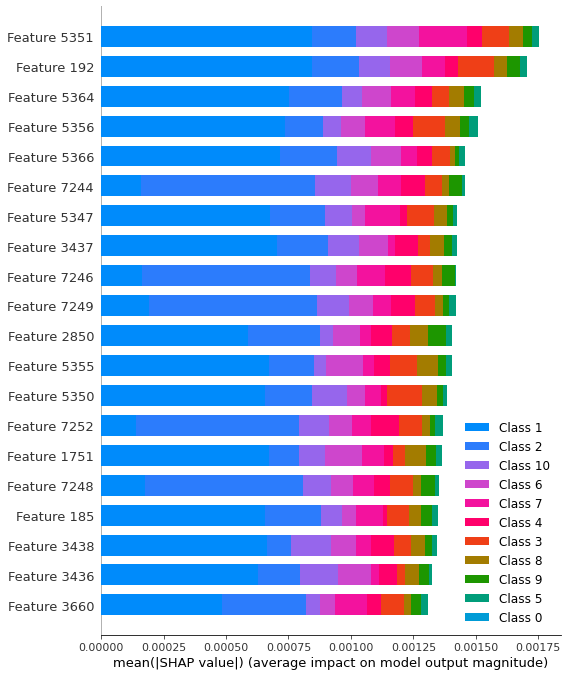

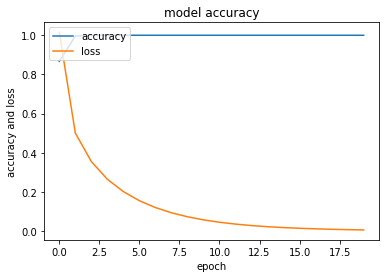

No positive samples in y_true, true positive value should be meaningless


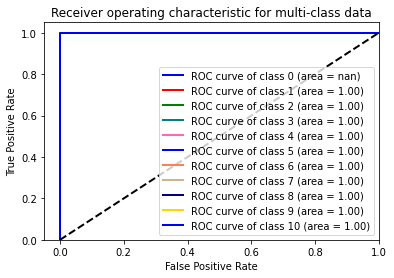

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62

In [15]:
df_delta= createdataframe("delta",1)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


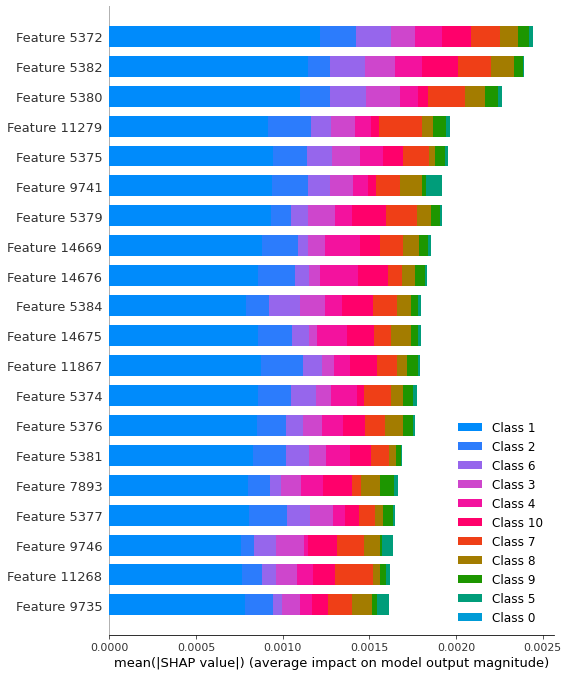

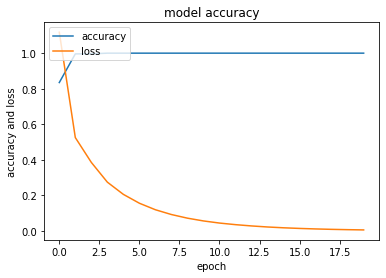

No positive samples in y_true, true positive value should be meaningless


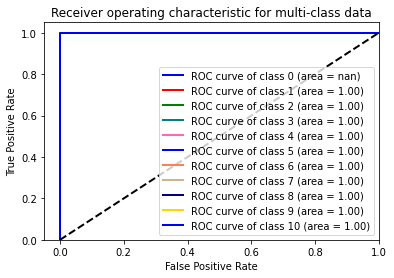

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62

In [16]:
df_delta= createdataframe("delta",2)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


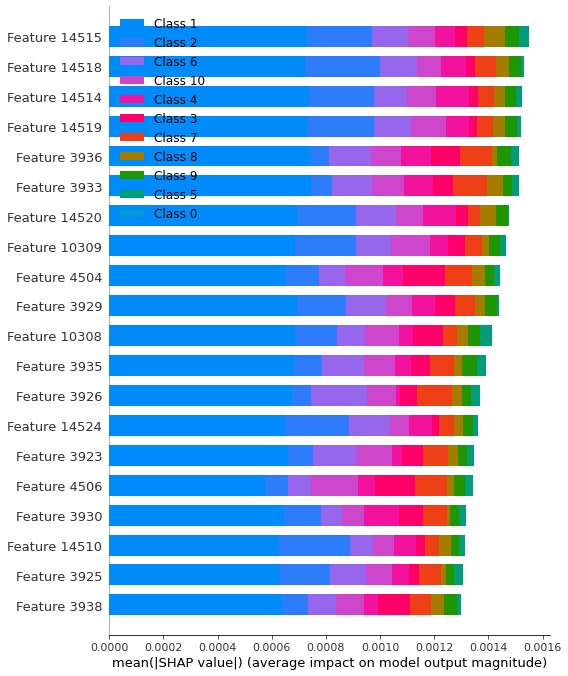

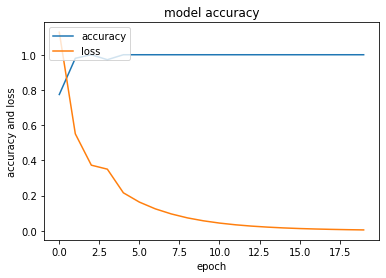

No positive samples in y_true, true positive value should be meaningless


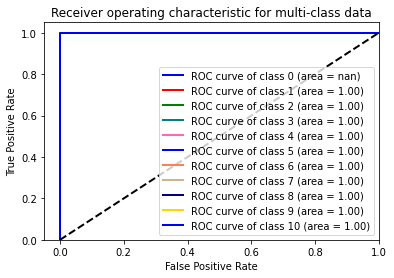

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62

In [17]:
df_delta= createdataframe("delta",3)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


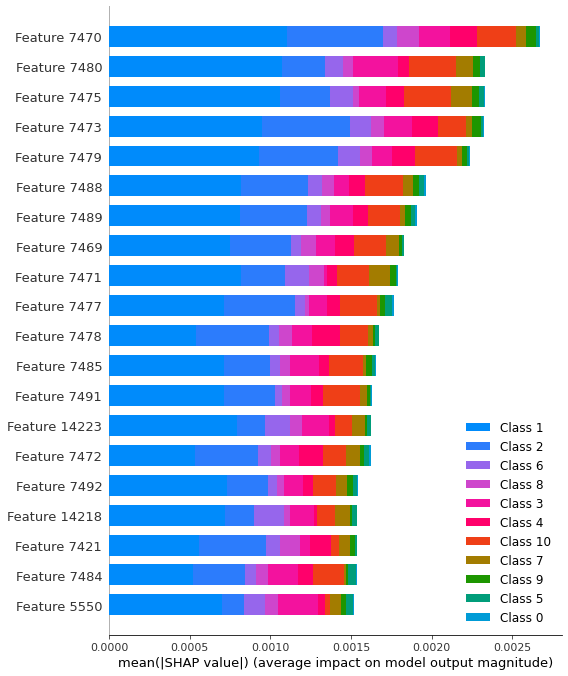

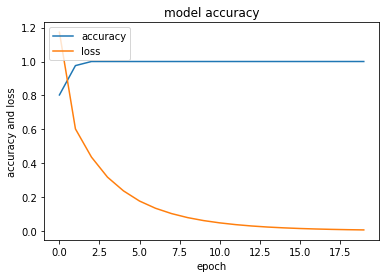

No positive samples in y_true, true positive value should be meaningless


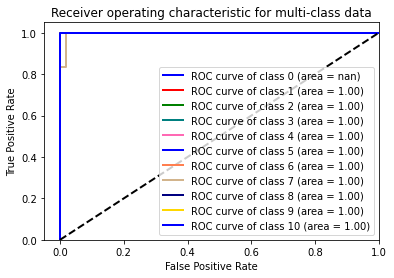

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 1 0]
 [0 0 0 0 0 0 5 0 0 0]
 [0 0 0 0 0 0 1 6 0 0]
 [0 0 0 0 0 0 0 0 2 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  0.967741935483871

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      0.90      0.95        10
           7       0.83      1.00      0.91         5
           8       1.00      0.86      0.92         7
           9       0.67      1.00      0.80         2
          10       1.00      1.00      1.00         8

    accuracy                           0.97        62
   macro avg       0.95      0.98      

In [18]:
df_delta= createdataframe("delta",4)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


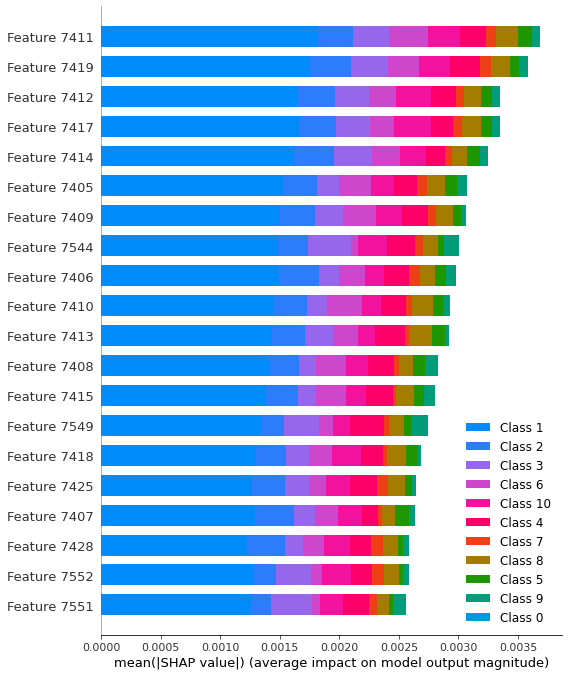

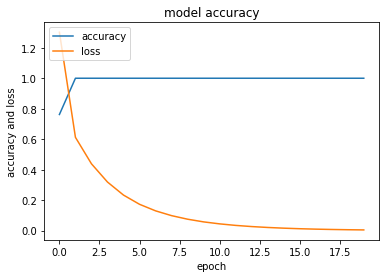

No positive samples in y_true, true positive value should be meaningless


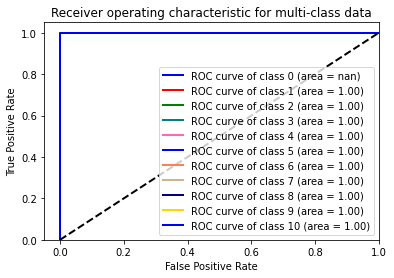

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62

In [19]:
df_delta= createdataframe("delta",5)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


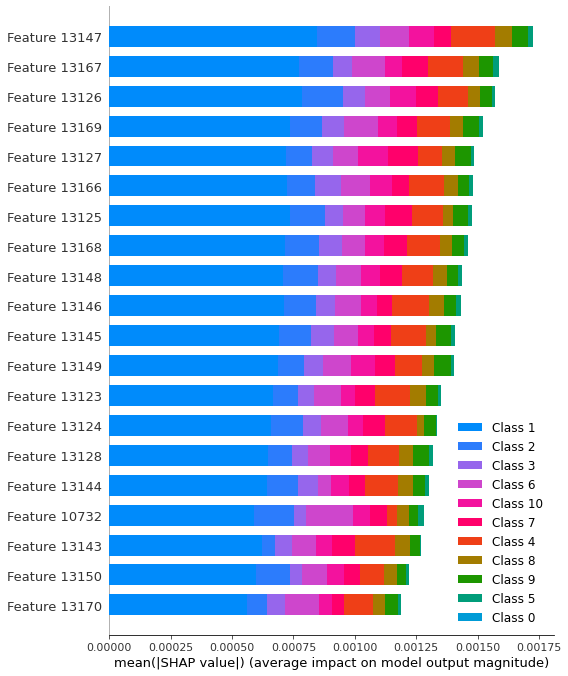

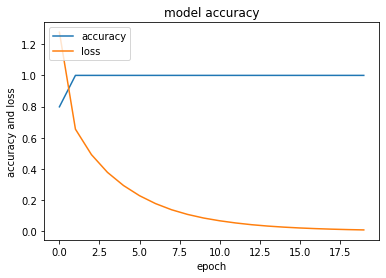

No positive samples in y_true, true positive value should be meaningless


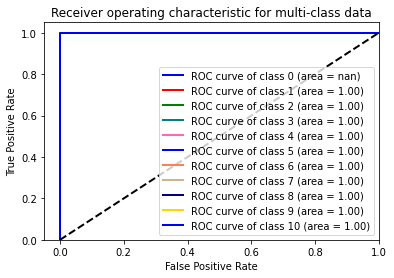

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62

In [20]:
df_theta= createdataframe("theta",1)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


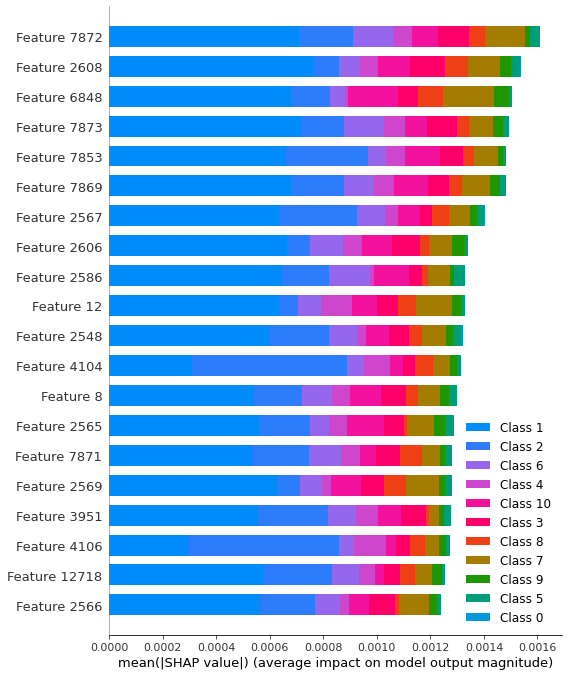

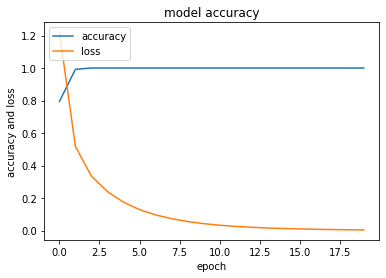

No positive samples in y_true, true positive value should be meaningless


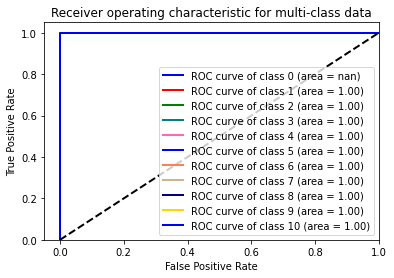

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62

In [21]:
df_theta= createdataframe("theta",2)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


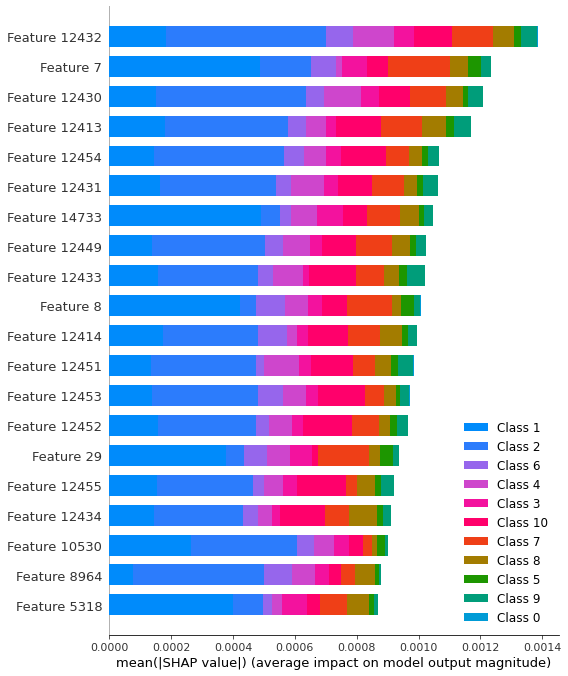

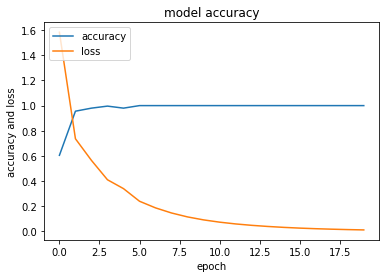

No positive samples in y_true, true positive value should be meaningless


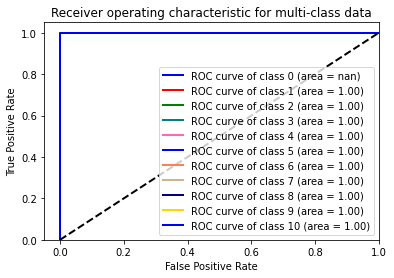

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 1]
 [0 0 0 0 0 9 0 1 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 5 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 7]]

accuracy score=  0.967741935483871

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      0.67      0.80         3
           6       1.00      0.90      0.95        10
           7       1.00      1.00      1.00         6
           8       0.83      1.00      0.91         5
           9       1.00      1.00      1.00         3
          10       0.88      1.00      0.93         7

    accuracy                           0.97        62
   macro avg       0.97      0.96      

In [22]:
df_theta= createdataframe("theta",3)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


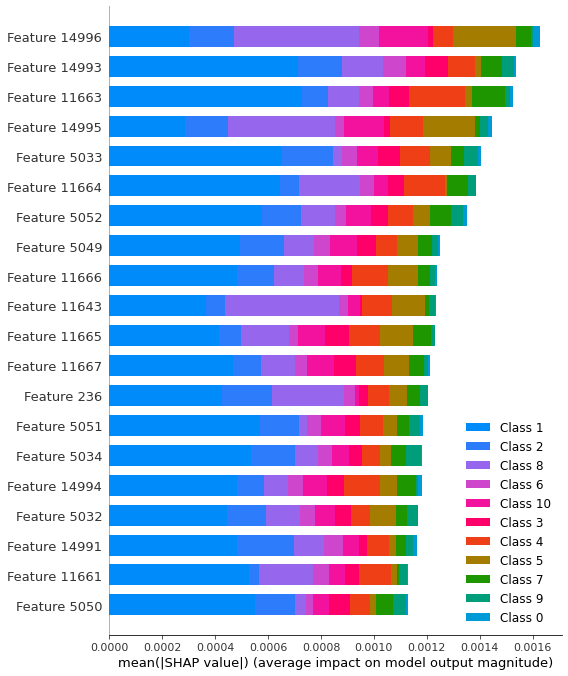

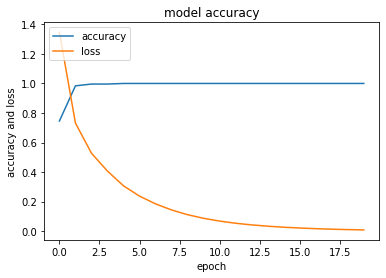

No positive samples in y_true, true positive value should be meaningless


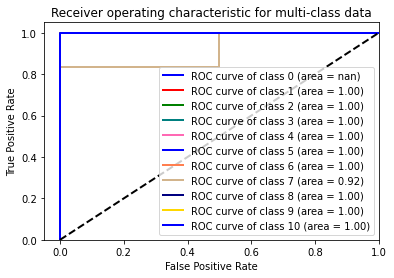

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 1 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 1]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 5 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 7]]

accuracy score=  0.967741935483871

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      0.86      0.92         7
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      0.67      0.80         3
           6       1.00      1.00      1.00         9
           7       0.83      1.00      0.91         5
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       0.88      1.00      0.93         7

    accuracy                           0.97        62
   macro avg       0.97      0.95      

In [23]:
df_theta= createdataframe("theta",4)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


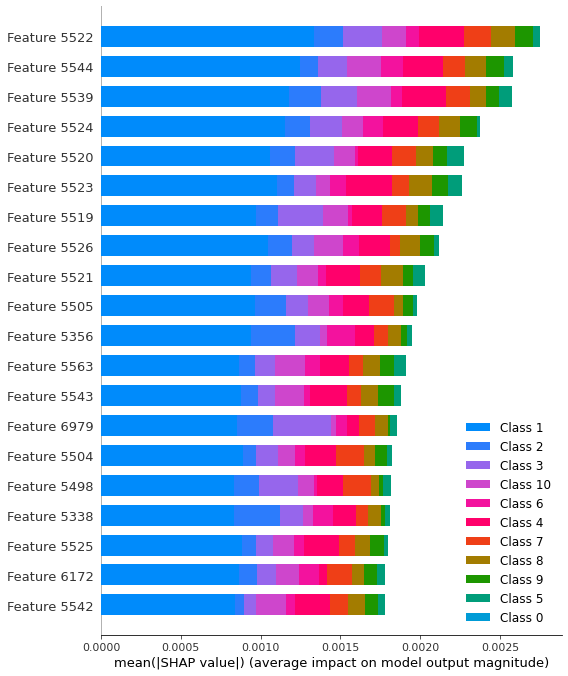

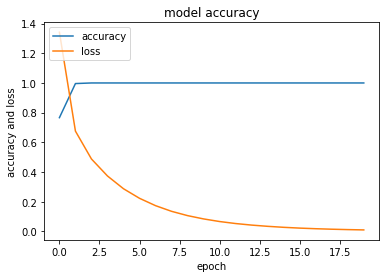

No positive samples in y_true, true positive value should be meaningless


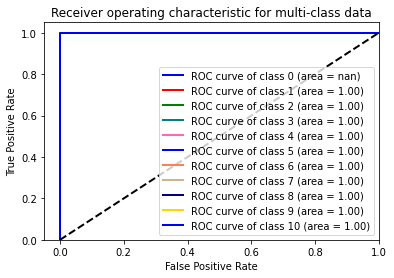

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62

In [24]:
df_theta= createdataframe("theta",5)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


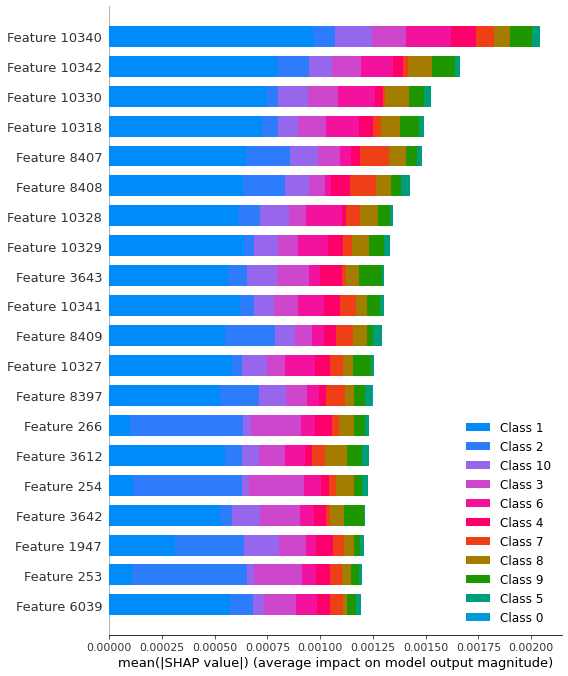

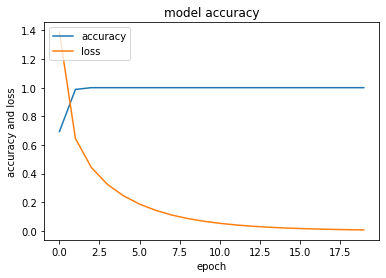

No positive samples in y_true, true positive value should be meaningless


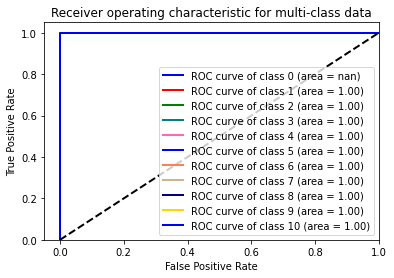

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 1]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 7]]

accuracy score=  0.9838709677419355

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      0.89      0.94         9
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       0.88      1.00      0.93         7

    accuracy                           0.98        62
   macro avg       0.99      0.99     

In [25]:
df_alpha= createdataframe("alpha",1)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


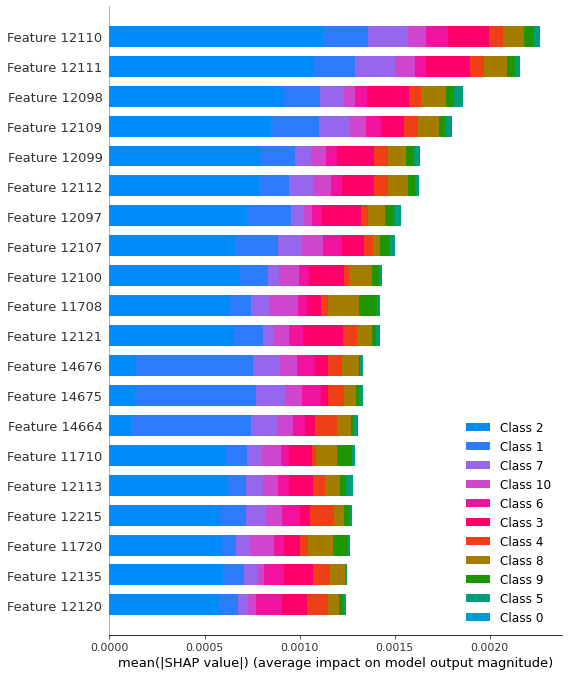

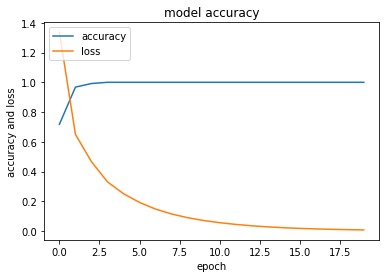

No positive samples in y_true, true positive value should be meaningless


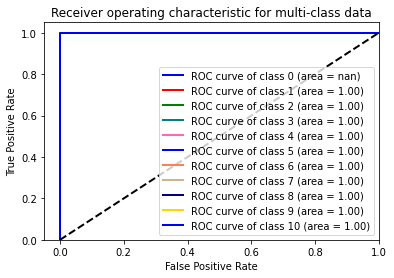

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62

In [26]:
df_alpha= createdataframe("alpha",2)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


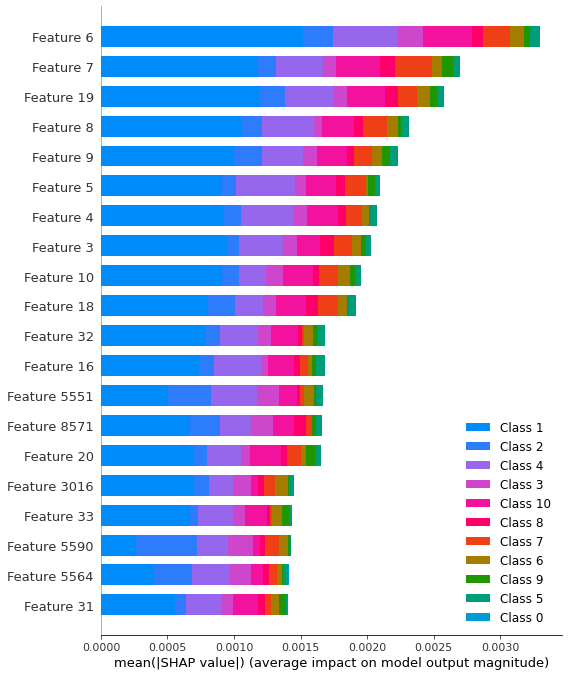

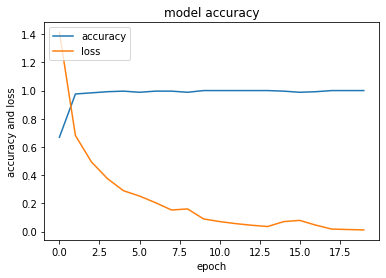

No positive samples in y_true, true positive value should be meaningless


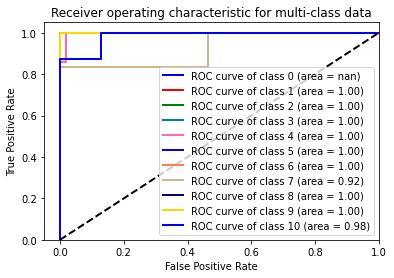

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 1]
 [0 0 0 7 0 0 2 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 4 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 7]]

accuracy score=  0.9516129032258065

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      0.89      0.94         9
           4       1.00      0.78      0.88         9
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       0.67      1.00      0.80         4
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       0.88      1.00      0.93         7

    accuracy                           0.95        62
   macro avg       0.95      0.97     

In [27]:
df_alpha= createdataframe("alpha",3)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


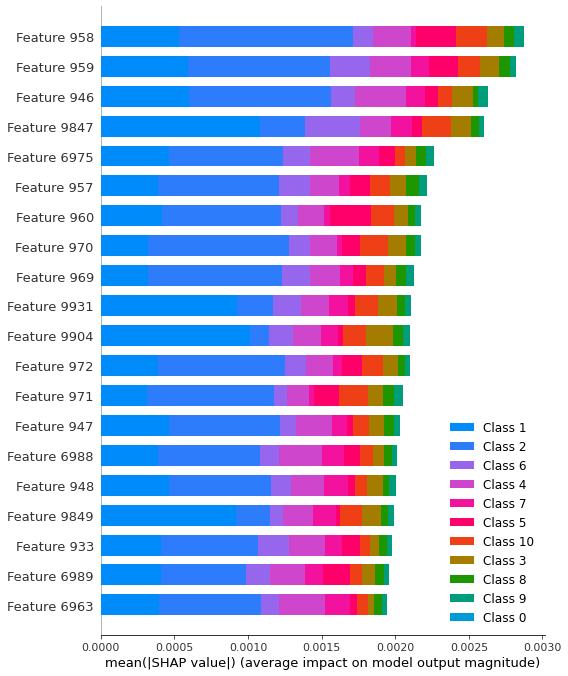

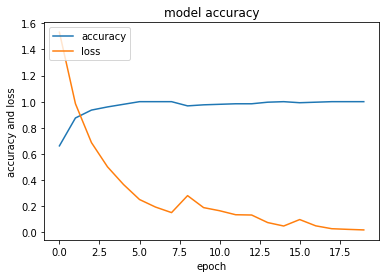

No positive samples in y_true, true positive value should be meaningless


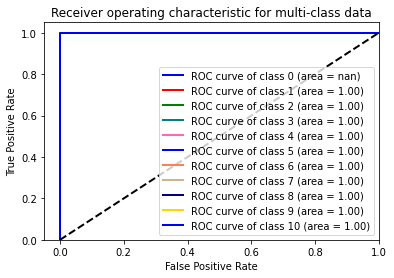

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 1 0 0 0 0 0]
 [0 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 5 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 1 0 0 8]]

accuracy score=  0.967741935483871

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      0.88      0.93         8
           5       0.50      1.00      0.67         1
           6       1.00      1.00      1.00         9
           7       0.83      1.00      0.91         5
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       1.00      0.89      0.94         9

    accuracy                           0.97        62
   macro avg       0.93      0.98      

In [28]:
df_alpha= createdataframe("alpha",4)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


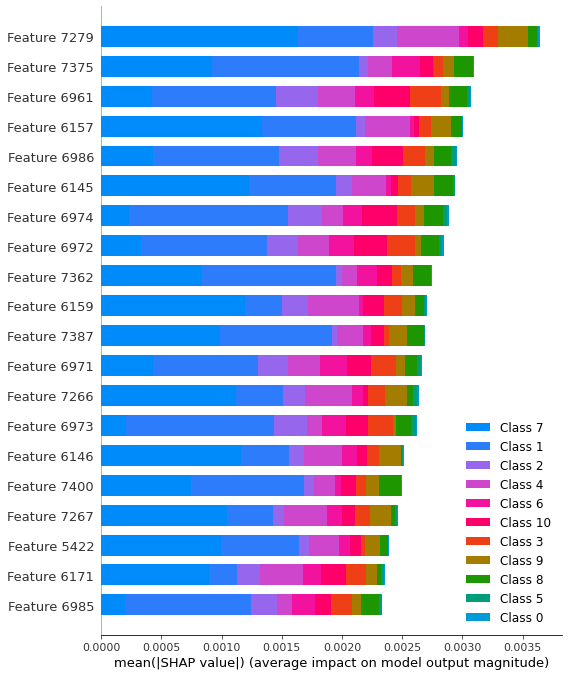

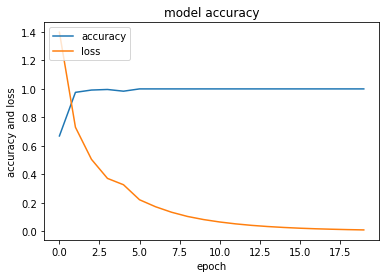

No positive samples in y_true, true positive value should be meaningless


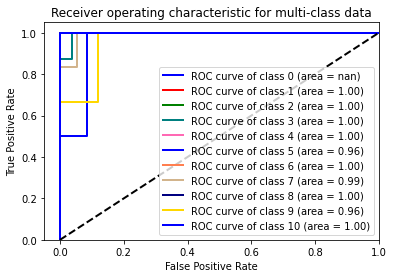

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 1 0 0 0 0 0 0 0]
 [0 0 7 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 1 9 1 0 1 0]
 [0 0 0 0 0 0 4 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 1 0 2 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  0.9193548387096774

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      0.86      0.92         7
           3       0.88      1.00      0.93         7
           4       1.00      1.00      1.00         7
           5       0.50      1.00      0.67         1
           6       1.00      0.75      0.86        12
           7       0.67      1.00      0.80         4
           8       1.00      1.00      1.00         6
           9       0.67      0.67      0.67         3
          10       1.00      1.00      1.00         8

    accuracy                           0.92        62
   macro avg       0.87      0.93     

In [29]:
df_alpha= createdataframe("alpha",5)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


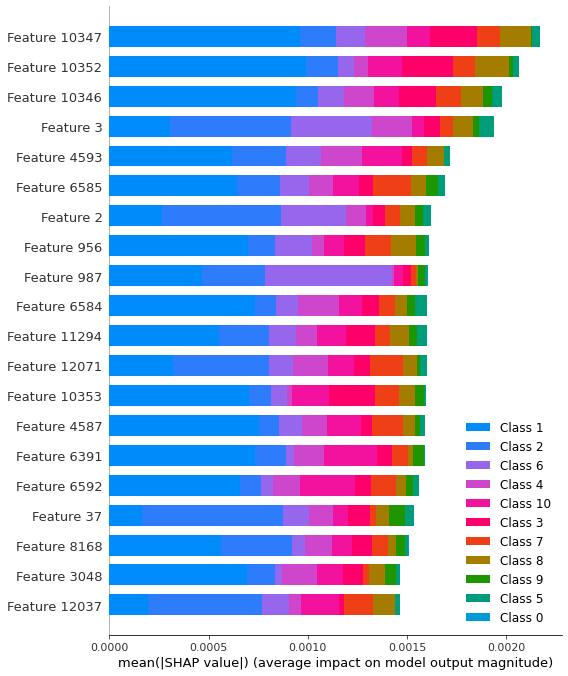

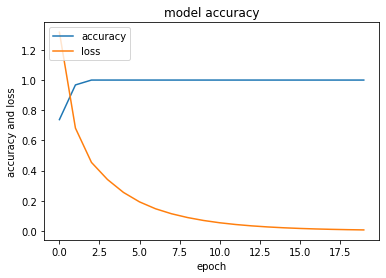

No positive samples in y_true, true positive value should be meaningless


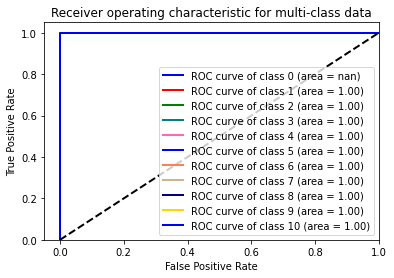

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         8

    accuracy                           1.00        62
   macro avg       1.00      1.00      1.00        62

In [30]:
df_beta= createdataframe("beta",1)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


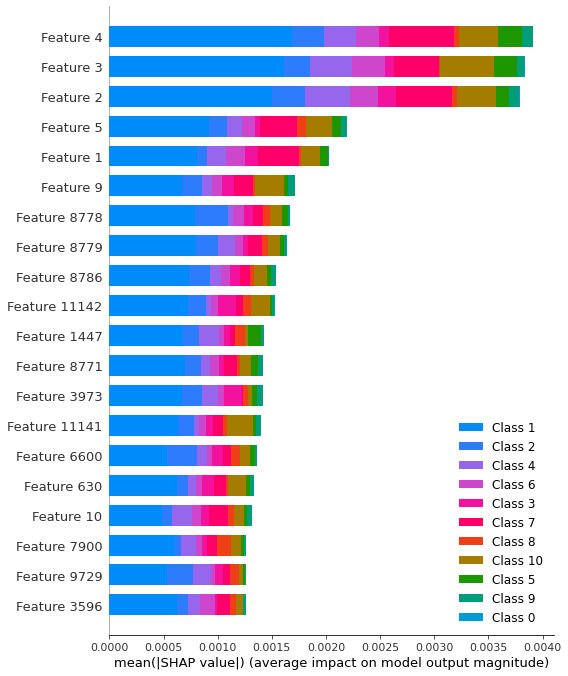

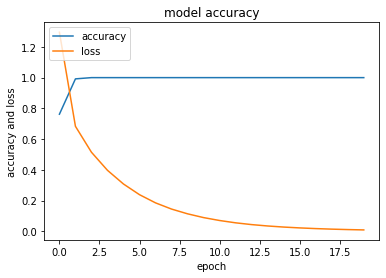

No positive samples in y_true, true positive value should be meaningless


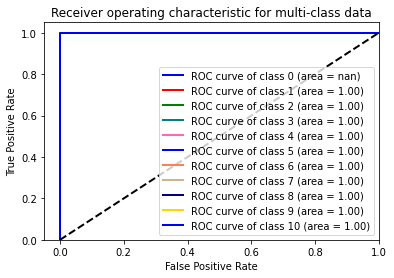

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 1]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 7]]

accuracy score=  0.9838709677419355

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      0.86      0.92         7
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       0.88      1.00      0.93         7

    accuracy                           0.98        62
   macro avg       0.99      0.99     

In [31]:
df_beta= createdataframe("beta",2)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


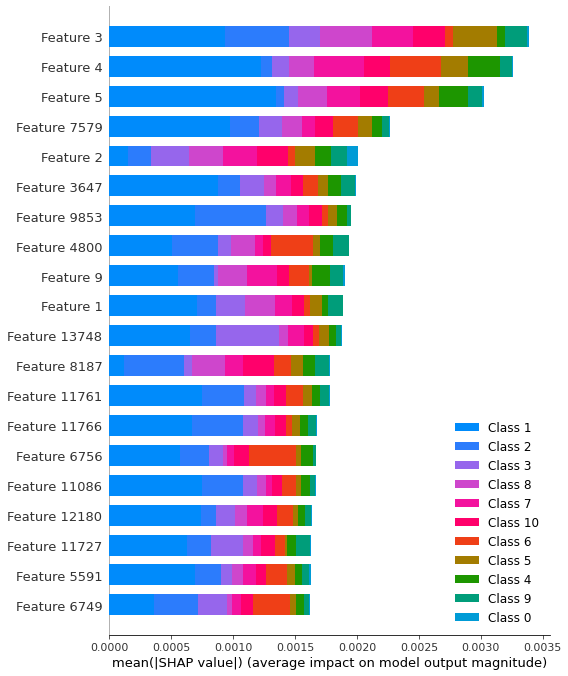

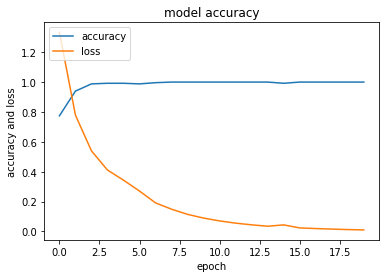

No positive samples in y_true, true positive value should be meaningless


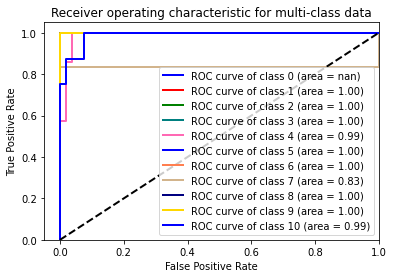

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 2]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 2 0 0 0 0 0 0]
 [0 0 0 4 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 5 0 0 0]
 [0 0 0 1 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 1 0 0 6]]

accuracy score=  0.9032258064516129

classification report

              precision    recall  f1-score   support

           1       1.00      0.78      0.88         9
           2       1.00      1.00      1.00         6
           3       1.00      0.80      0.89        10
           4       0.57      1.00      0.73         4
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       0.83      1.00      0.91         5
           8       1.00      0.86      0.92         7
           9       1.00      1.00      1.00         3
          10       0.75      0.86      0.80         7

    accuracy                           0.90        62
   macro avg       0.92      0.93     

In [32]:
df_beta= createdataframe("beta",3)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


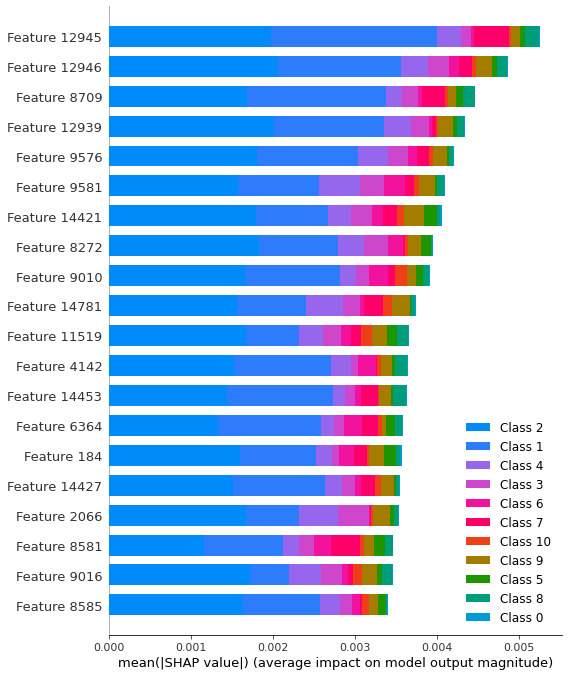

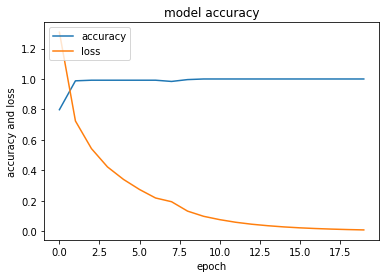

No positive samples in y_true, true positive value should be meaningless


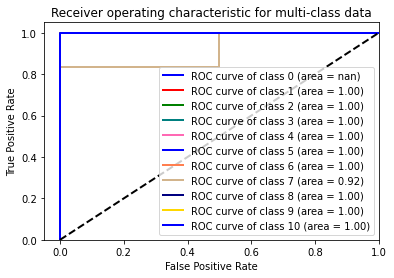

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 1]
 [0 0 0 0 2 0 0 0 0 1]
 [0 0 0 0 0 9 1 0 0 0]
 [0 0 0 0 0 0 5 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 6]]

accuracy score=  0.9516129032258065

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      0.88      0.93         8
           5       1.00      0.67      0.80         3
           6       1.00      0.90      0.95        10
           7       0.83      1.00      0.91         5
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       0.75      1.00      0.86         6

    accuracy                           0.95        62
   macro avg       0.96      0.94     

In [33]:
df_beta= createdataframe("beta",4)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


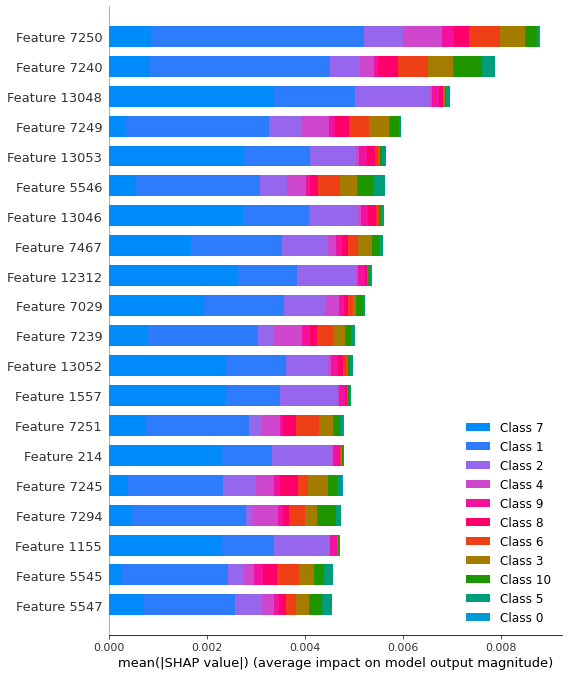

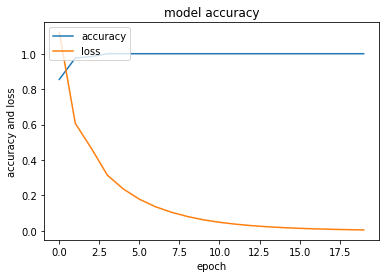

No positive samples in y_true, true positive value should be meaningless


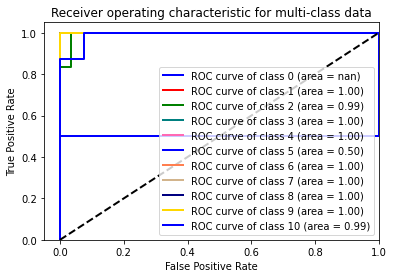

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 1]
 [0 5 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 1 0 0 0 0 0]
 [0 1 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 7]]

accuracy score=  0.9516129032258065

classification report

              precision    recall  f1-score   support

           1       1.00      0.88      0.93         8
           2       0.83      1.00      0.91         5
           3       1.00      1.00      1.00         8
           4       1.00      0.88      0.93         8
           5       0.50      0.50      0.50         2
           6       1.00      1.00      1.00         9
           7       1.00      1.00      1.00         6
           8       1.00      1.00      1.00         6
           9       1.00      1.00      1.00         3
          10       0.88      1.00      0.93         7

    accuracy                           0.95        62
   macro avg       0.92      0.93     

In [34]:
df_beta= createdataframe("beta",5)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


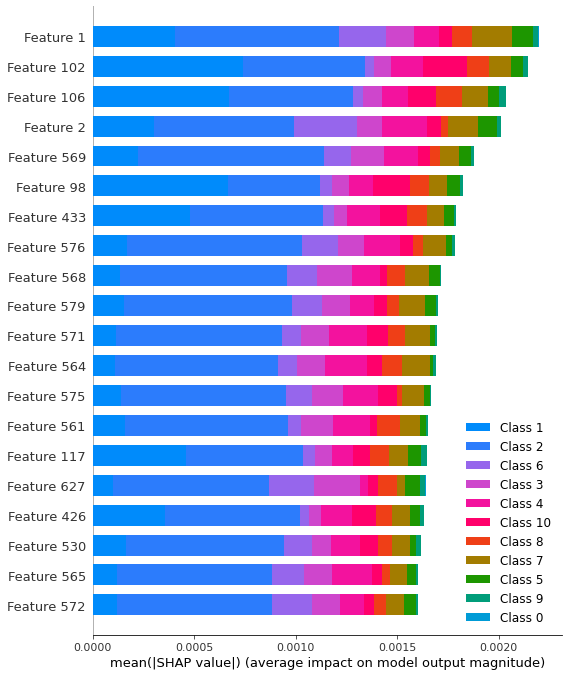

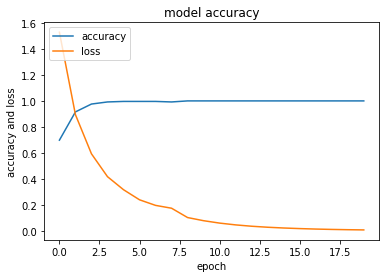

No positive samples in y_true, true positive value should be meaningless


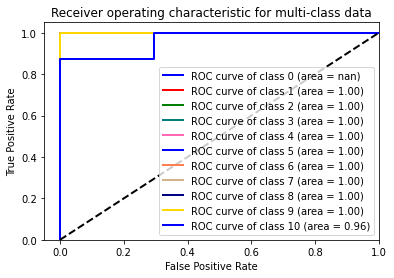

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 1]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 1 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 1 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 5 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 2 0]
 [0 0 0 0 0 0 0 0 0 7]]

accuracy score=  0.9516129032258065

classification report

              precision    recall  f1-score   support

           1       1.00      0.88      0.93         8
           2       1.00      1.00      1.00         6
           3       1.00      0.89      0.94         9
           4       1.00      1.00      1.00         7
           5       1.00      0.67      0.80         3
           6       1.00      1.00      1.00         9
           7       0.83      1.00      0.91         5
           8       1.00      1.00      1.00         6
           9       0.67      1.00      0.80         2
          10       0.88      1.00      0.93         7

    accuracy                           0.95        62
   macro avg       0.94      0.94     

In [35]:
df_gamma= createdataframe("gamma",1)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


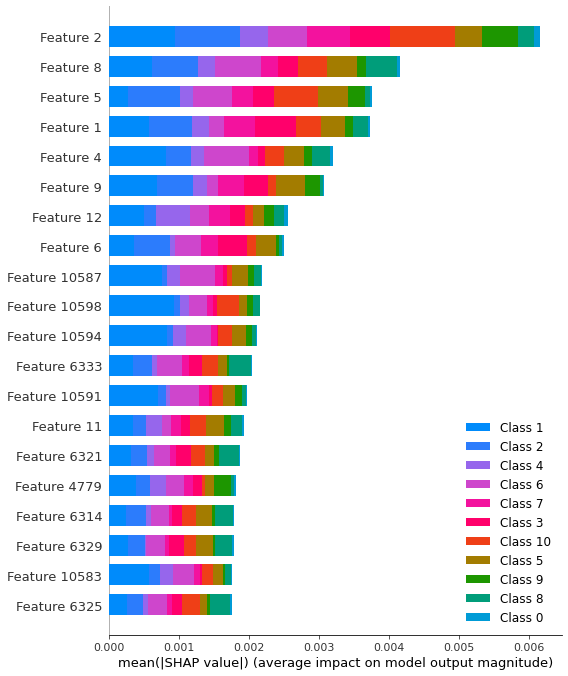

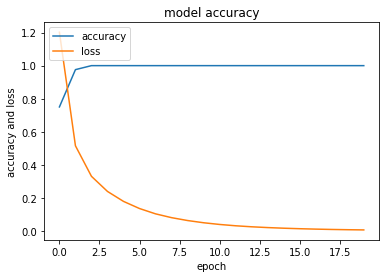

No positive samples in y_true, true positive value should be meaningless


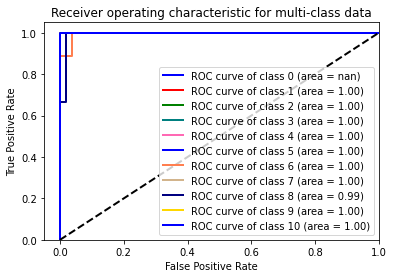

confusion matrix 

 [[7 0 0 0 0 0 0 0 0 0]
 [0 6 0 0 0 0 0 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 1 0 0]
 [0 0 0 0 0 8 0 1 0 0]
 [0 0 0 0 0 1 6 0 0 0]
 [0 0 0 0 0 0 0 4 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 8]]

accuracy score=  0.9516129032258065

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         6
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      0.67      0.80         3
           6       0.89      0.89      0.89         9
           7       1.00      0.86      0.92         7
           8       0.67      1.00      0.80         4
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         8

    accuracy                           0.95        62
   macro avg       0.96      0.94     

In [36]:
df_gamma= createdataframe("gamma",2)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


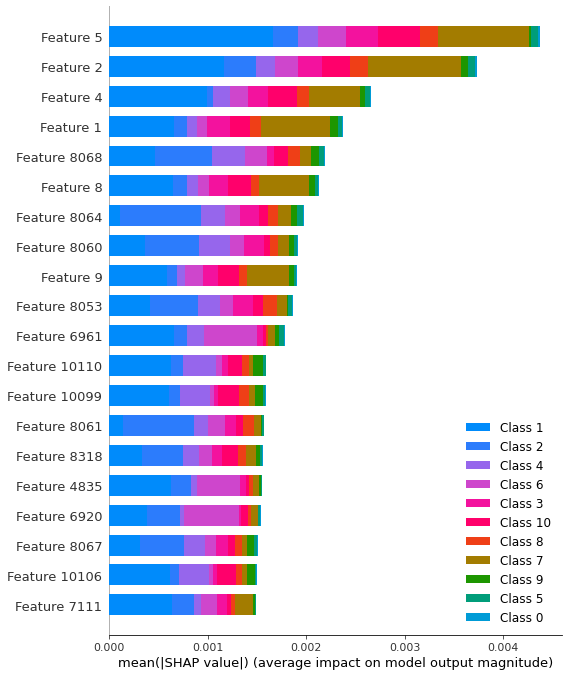

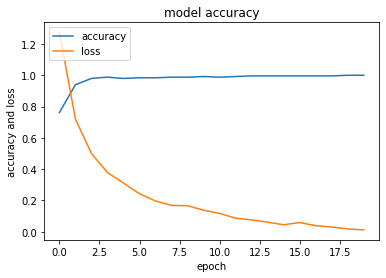

No positive samples in y_true, true positive value should be meaningless


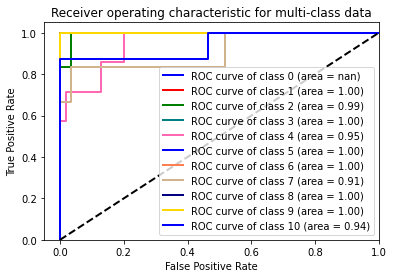

confusion matrix 

 [[7 0 1 2 0 0 2 0 0 1]
 [0 5 0 0 0 0 0 0 0 0]
 [0 0 7 0 0 0 0 0 0 0]
 [0 0 0 5 0 0 0 0 1 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 4 0 0 0]
 [0 1 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 0 2 0]
 [0 0 0 0 0 0 0 0 0 7]]

accuracy score=  0.8709677419354839

classification report

              precision    recall  f1-score   support

           1       1.00      0.54      0.70        13
           2       0.83      1.00      0.91         5
           3       0.88      1.00      0.93         7
           4       0.71      0.83      0.77         6
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       0.67      1.00      0.80         4
           8       1.00      0.86      0.92         7
           9       0.67      1.00      0.80         2
          10       0.88      1.00      0.93         7

    accuracy                           0.87        62
   macro avg       0.86      0.92     

In [37]:
df_gamma= createdataframe("gamma",3)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


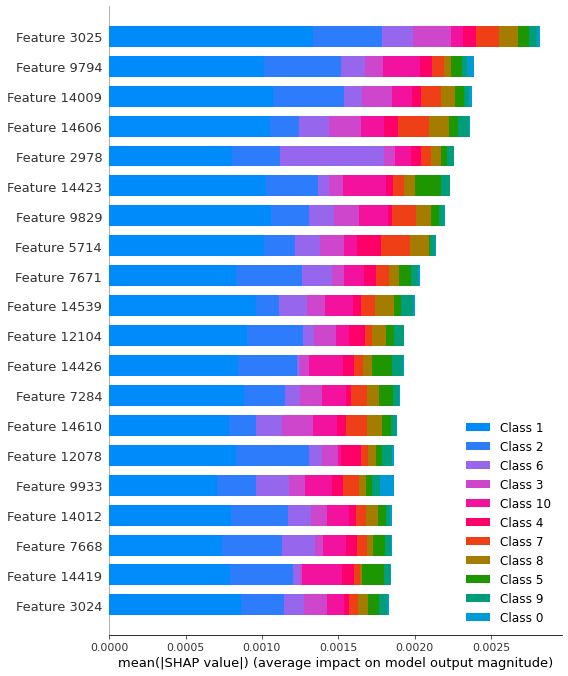

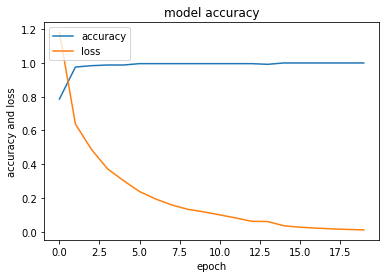

No positive samples in y_true, true positive value should be meaningless


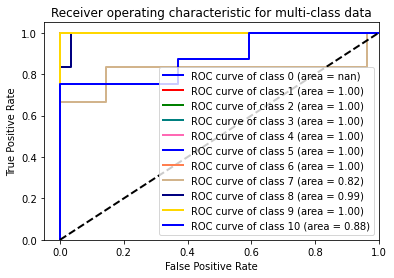

confusion matrix 

 [[7 0 0 0 0 0 1 1 0 2]
 [0 6 0 0 0 0 1 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 7 0 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0 0]
 [0 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 4 0 0 0]
 [0 0 0 0 0 0 0 4 0 0]
 [0 0 0 0 0 0 0 1 3 0]
 [0 0 0 0 0 0 0 0 0 6]]

accuracy score=  0.9032258064516129

classification report

              precision    recall  f1-score   support

           1       1.00      0.64      0.78        11
           2       1.00      0.86      0.92         7
           3       1.00      1.00      1.00         8
           4       1.00      1.00      1.00         7
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         9
           7       0.67      1.00      0.80         4
           8       0.67      1.00      0.80         4
           9       1.00      0.75      0.86         4
          10       0.75      1.00      0.86         6

    accuracy                           0.90        62
   macro avg       0.91      0.92     

In [38]:
df_gamma= createdataframe("gamma",4)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


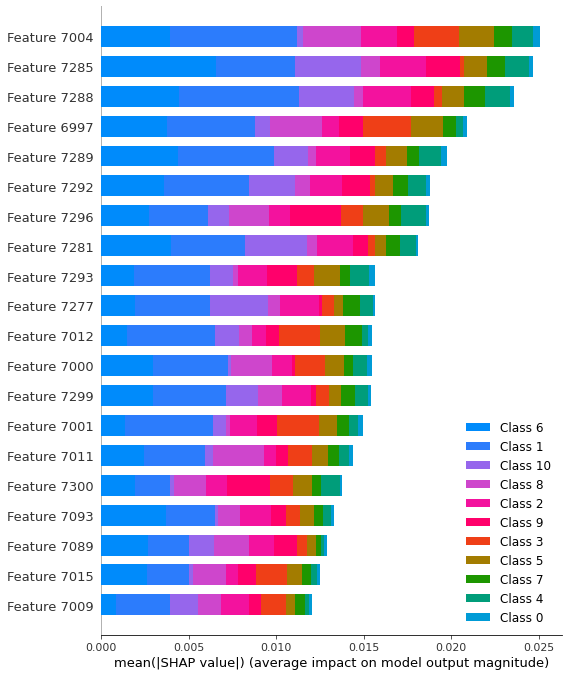

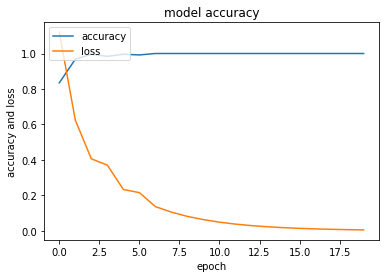

No positive samples in y_true, true positive value should be meaningless


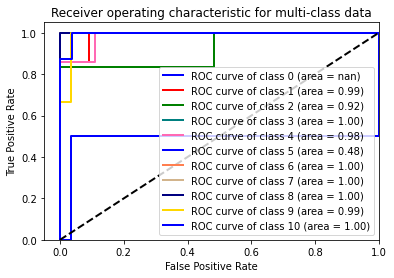

confusion matrix 

 [[6 0 0 0 1 0 0 0 1 0]
 [0 5 0 0 0 0 1 0 0 0]
 [0 0 8 0 0 0 0 0 0 0]
 [0 0 0 6 0 0 0 0 0 0]
 [0 1 0 1 0 0 0 0 0 0]
 [1 0 0 0 0 9 0 0 0 0]
 [0 0 0 0 0 0 5 0 0 0]
 [0 0 0 0 0 0 0 6 0 0]
 [0 0 0 0 1 0 0 0 2 1]
 [0 0 0 0 0 0 0 0 0 7]]

accuracy score=  0.8709677419354839

classification report

              precision    recall  f1-score   support

           1       0.86      0.75      0.80         8
           2       0.83      0.83      0.83         6
           3       1.00      1.00      1.00         8
           4       0.86      1.00      0.92         6
           5       0.00      0.00      0.00         2
           6       1.00      0.90      0.95        10
           7       0.83      1.00      0.91         5
           8       1.00      1.00      1.00         6
           9       0.67      0.50      0.57         4
          10       0.88      1.00      0.93         7

    accuracy                           0.87        62
   macro avg       0.79      0.80     

In [39]:
df_gamma= createdataframe("gamma",5)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

In [15]:

def createdataframeleft(signal_fiq,user):
    global Intencity
    tem_signal = []
    print(signal_fiq)
    eeg_person = EEG(user)
    for i in Intencity:
        for ch in range(0,31,2):
            S = 'tem_signal.append(np.append(eeg_person.'+signal_fiq+'.get(i)[:,ch][0:15000],i))' 
            eval(S)
      #  tem_signal.append(np.append(eeg_person.A.get(i)[:,ch][0:15000],i))

    return pd.DataFrame(tem_signal) 

In [16]:
def createdataframeright(signal_fiq,user):
    global Intencity
    tem_signal = []
    print(signal_fiq)
    eeg_person = EEG(user)
    for i in Intencity:
        for ch in range(1,31,2):
            S = 'tem_signal.append(np.append(eeg_person.'+signal_fiq+'.get(i)[:,ch][0:15000],i))' 
            eval(S)
      #  tem_signal.append(np.append(eeg_person.A.get(i)[:,ch][0:15000],i))

    return pd.DataFrame(tem_signal)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


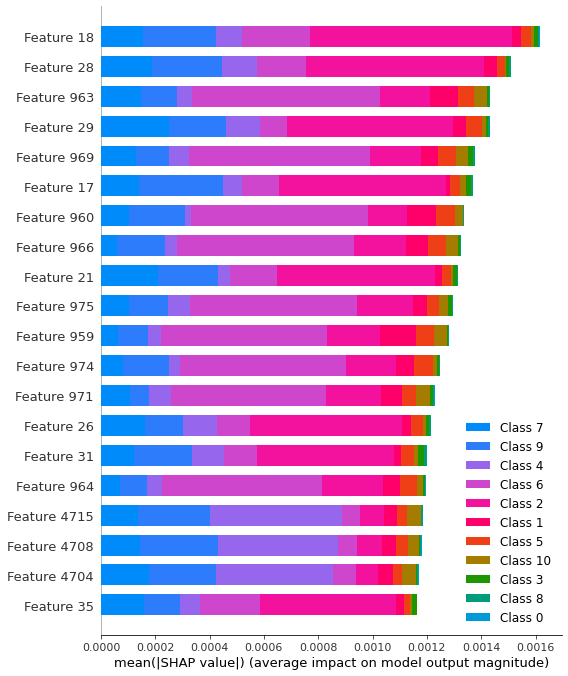

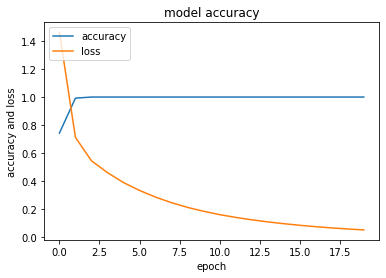

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


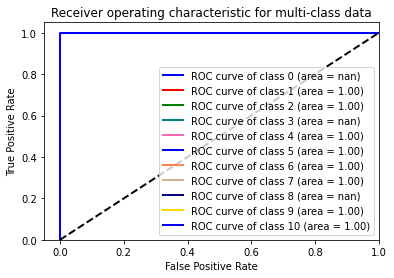

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [49]:
df_delta= createdataframeleft("delta",1)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


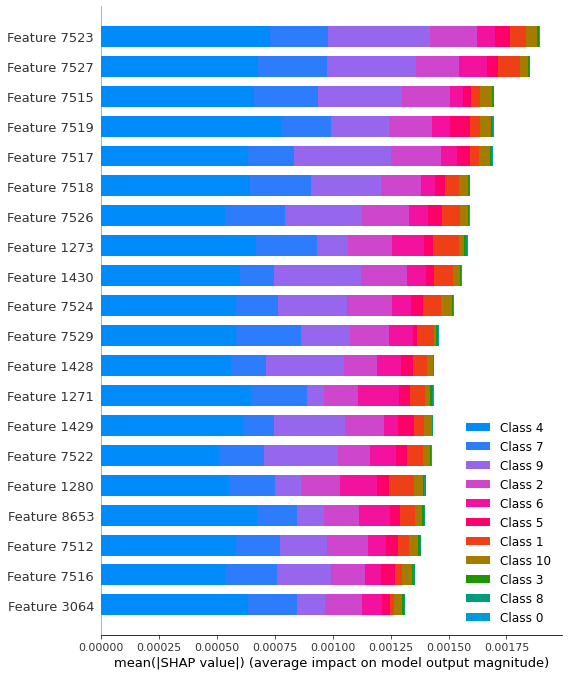

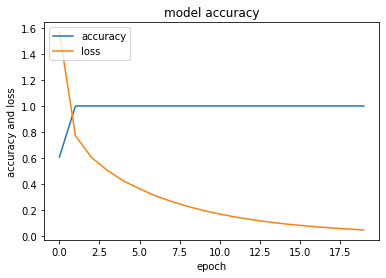

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


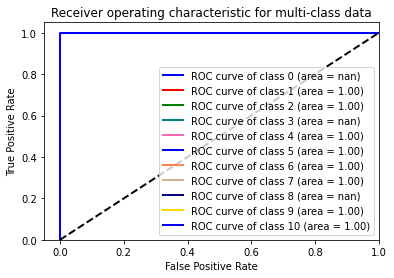

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [50]:
df_delta= createdataframeleft("delta",2)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


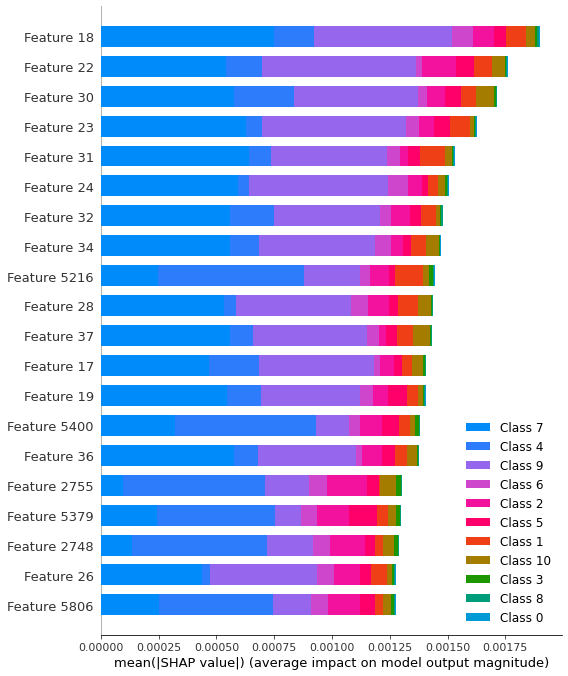

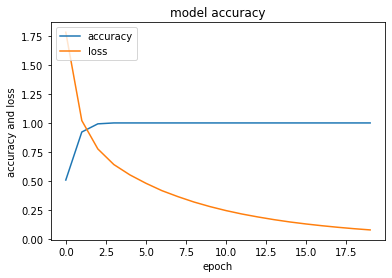

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


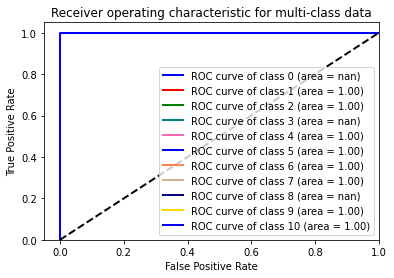

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [51]:
df_delta= createdataframeleft("delta",3)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


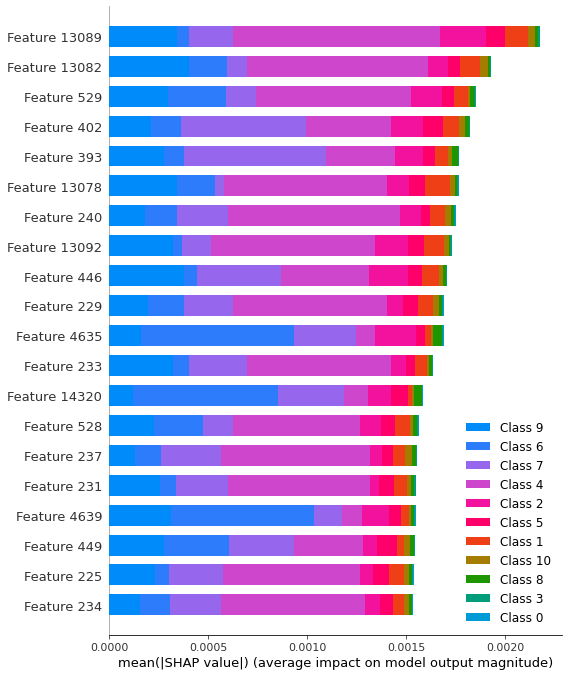

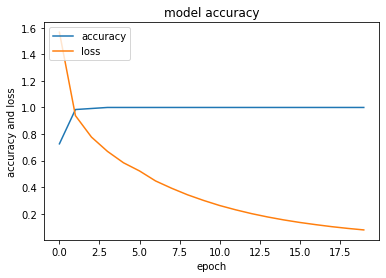

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


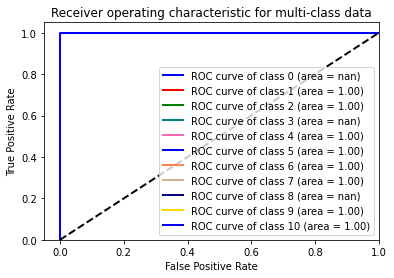

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [52]:
df_delta= createdataframeleft("delta",4)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


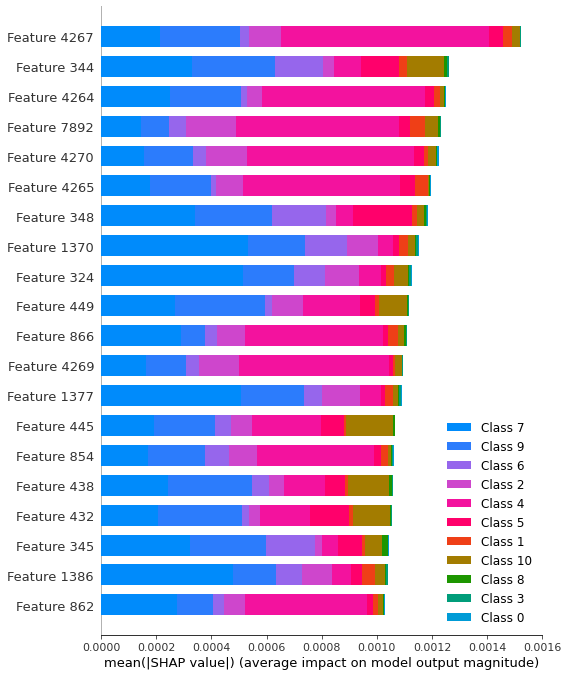

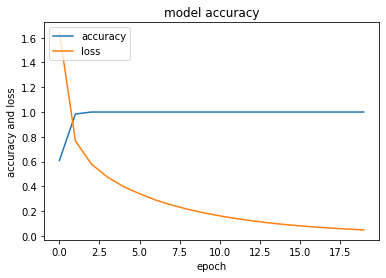

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


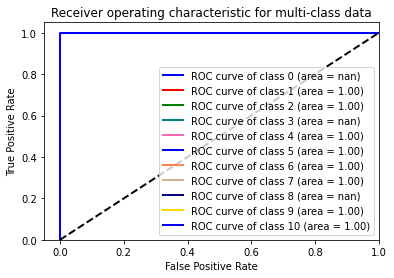

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [53]:
df_delta= createdataframeleft("delta",5)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


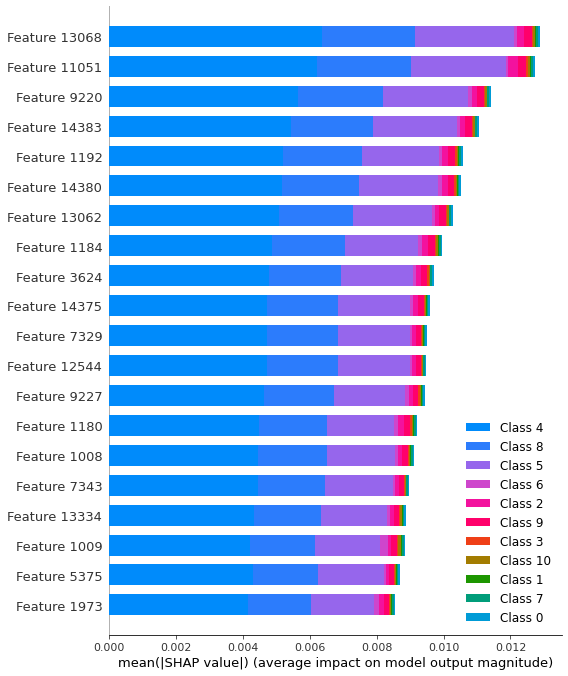

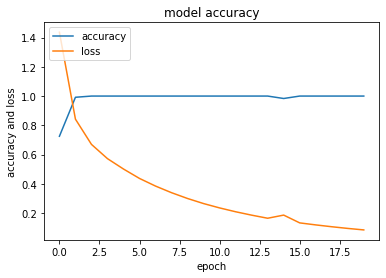

No positive samples in y_true, true positive value should be meaningless


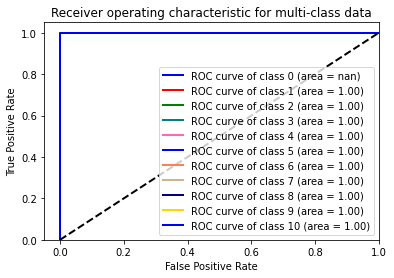

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [54]:
df_delta= createdataframeright("delta",1)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


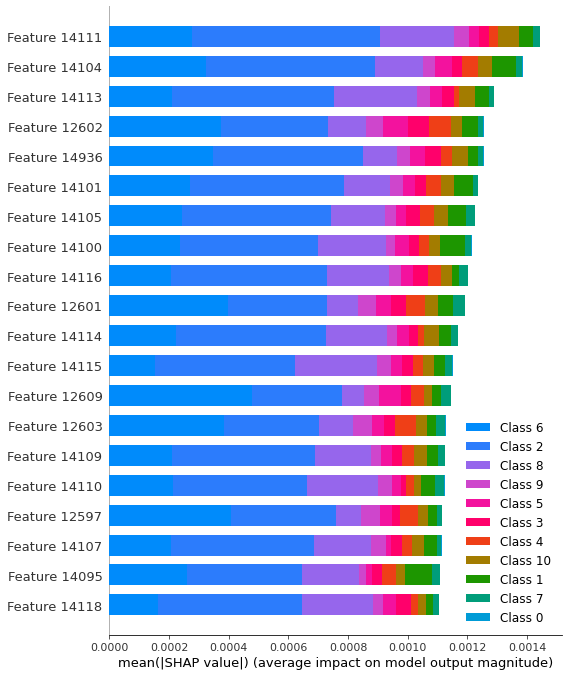

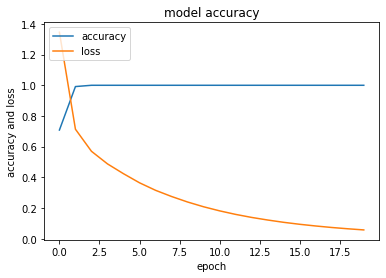

No positive samples in y_true, true positive value should be meaningless


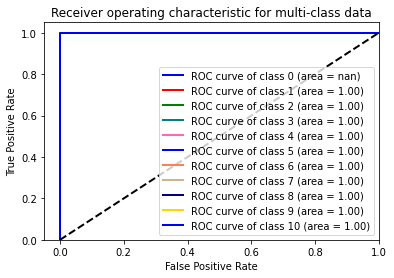

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [55]:
df_delta= createdataframeright("delta",2)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


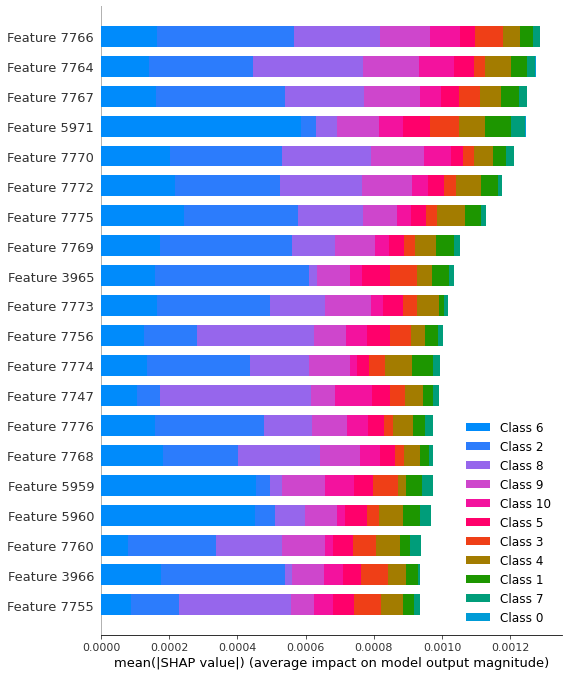

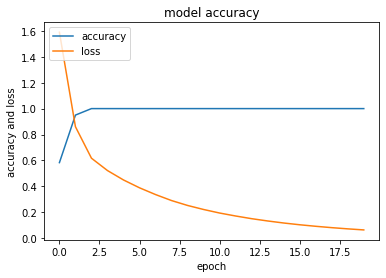

No positive samples in y_true, true positive value should be meaningless


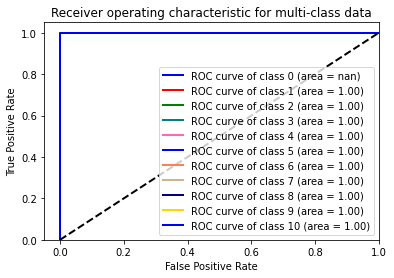

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [56]:
df_delta= createdataframeright("delta",3)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


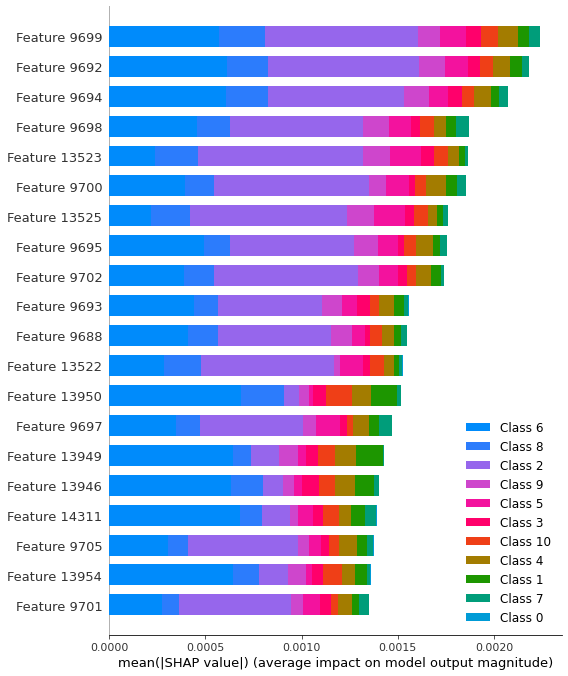

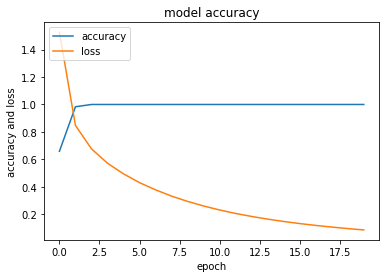

No positive samples in y_true, true positive value should be meaningless


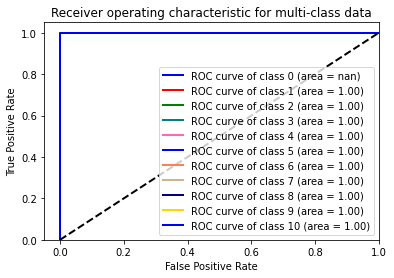

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [57]:
df_delta= createdataframeright("delta",4)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

delta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


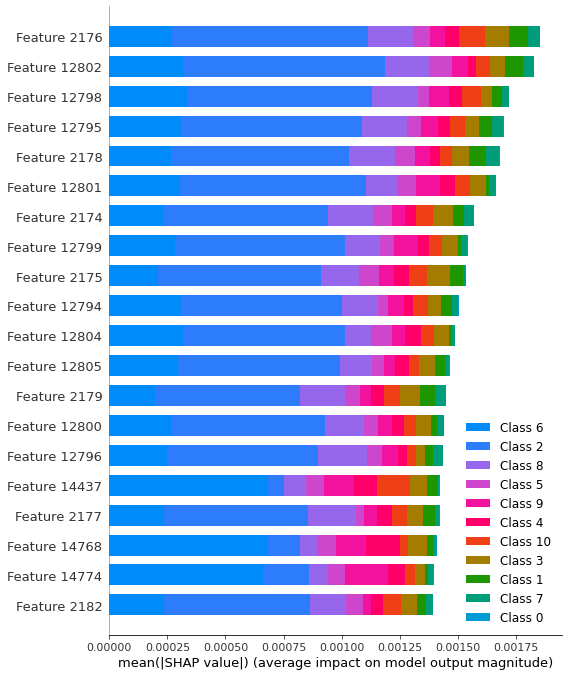

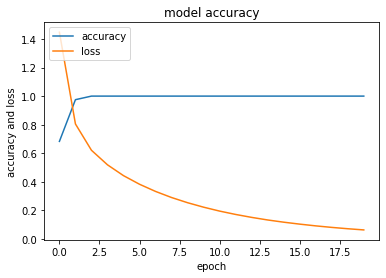

No positive samples in y_true, true positive value should be meaningless


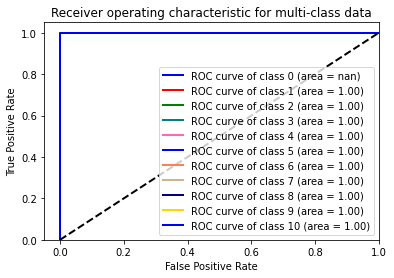

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [58]:
df_delta= createdataframeright("delta",5)
classification_report_delta = createmodel(df_delta)
print(classification_report_delta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


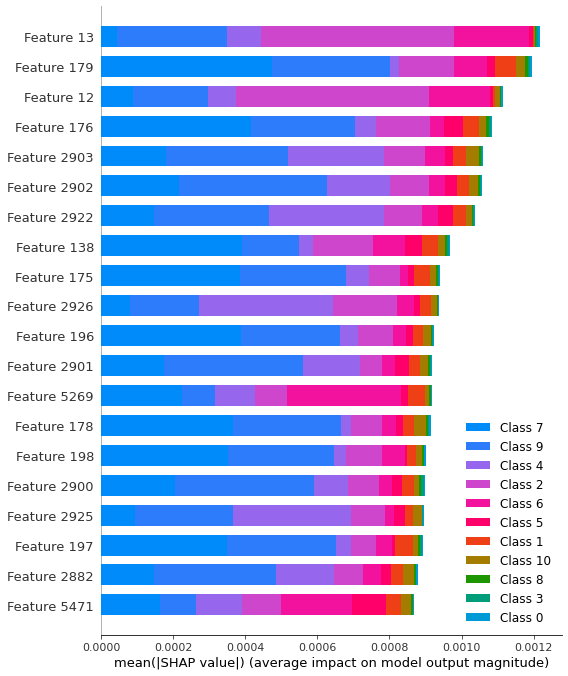

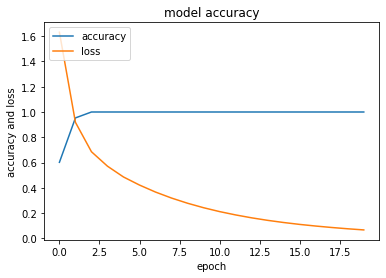

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


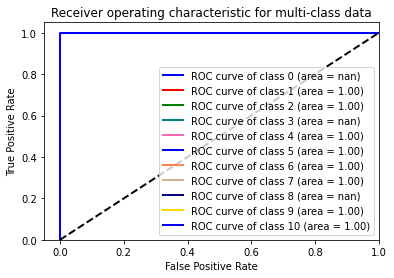

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [59]:
df_theta= createdataframeleft("theta",1)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


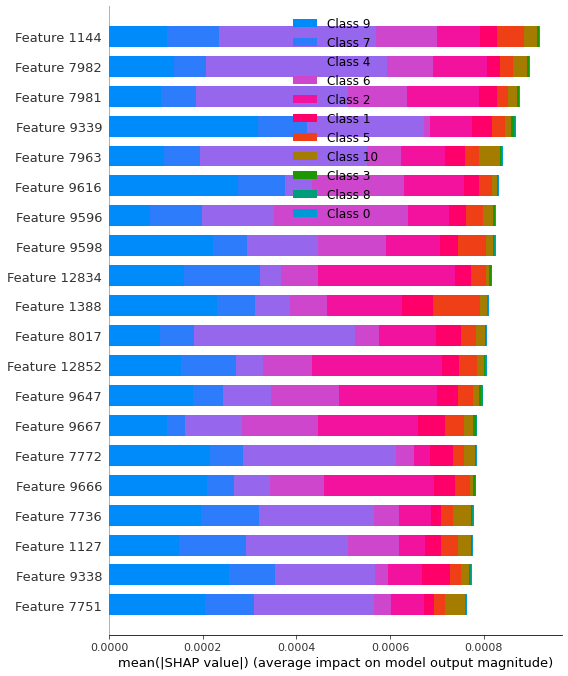

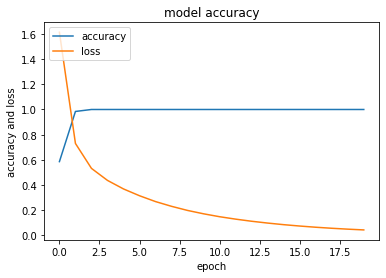

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


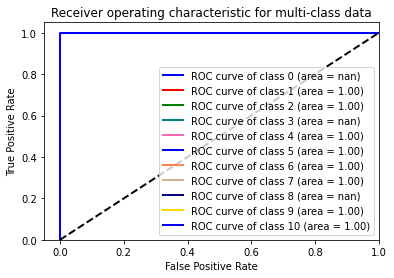

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [60]:
df_theta= createdataframeleft("theta",2)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


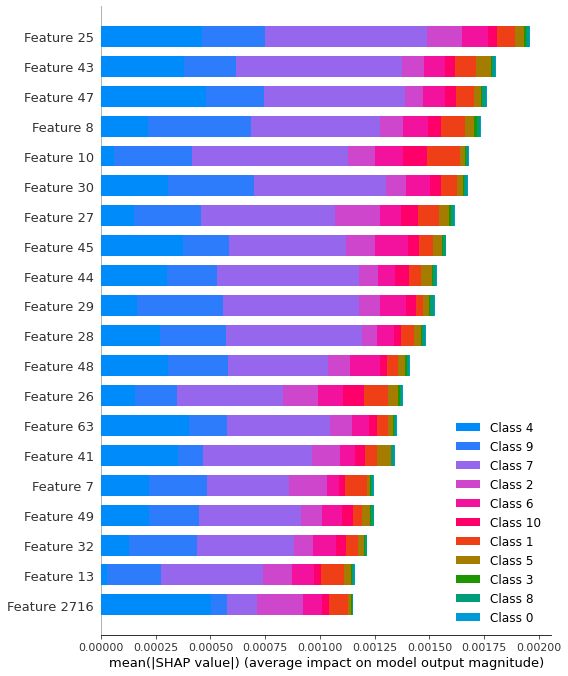

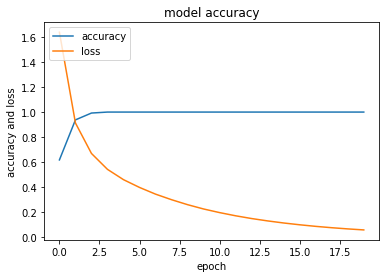

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


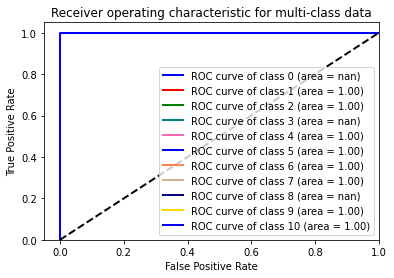

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [61]:
df_theta= createdataframeleft("theta",3)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


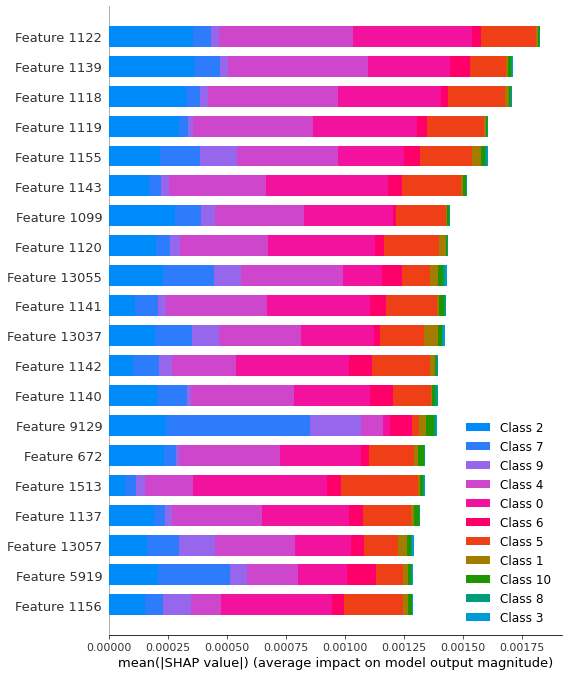

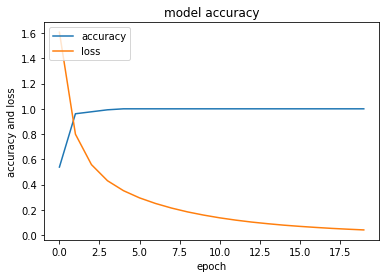

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


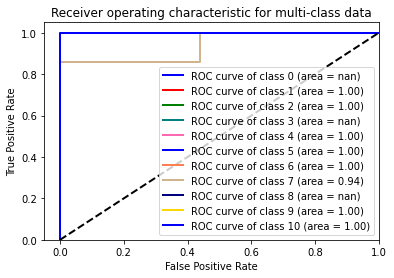

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 1 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  0.96875

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      0.88      0.93         8
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       0.86      1.00      0.92         6
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.98      0.98      0.98        32
weighted avg       0.97      0.97      0.97        32


    class  sensitivity  specificity
0    1.0         1.00     1.000000

In [62]:
df_theta= createdataframeleft("theta",4)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


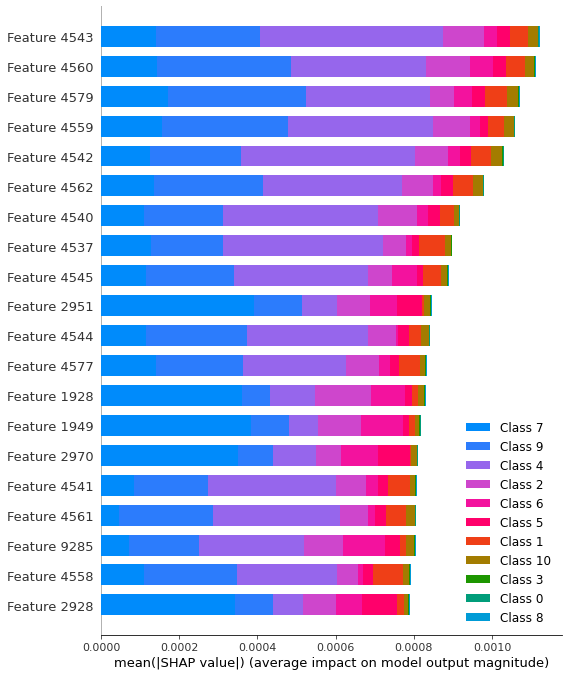

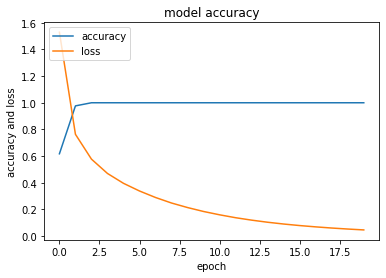

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


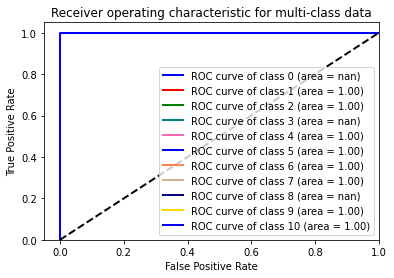

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [63]:
df_theta= createdataframeleft("theta",5)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


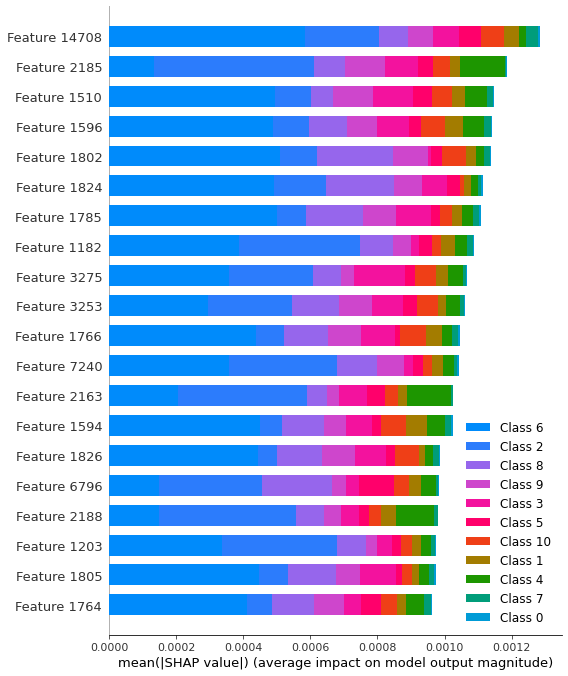

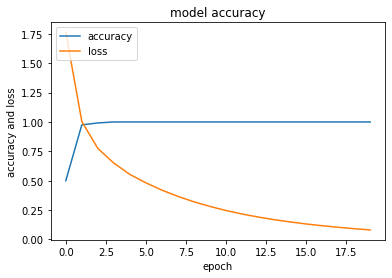

No positive samples in y_true, true positive value should be meaningless


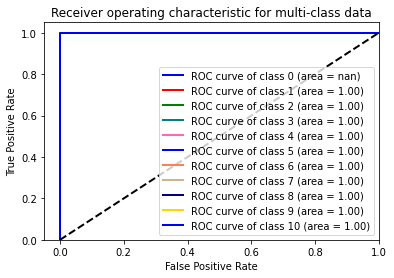

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [64]:
df_theta= createdataframeright("theta",1)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


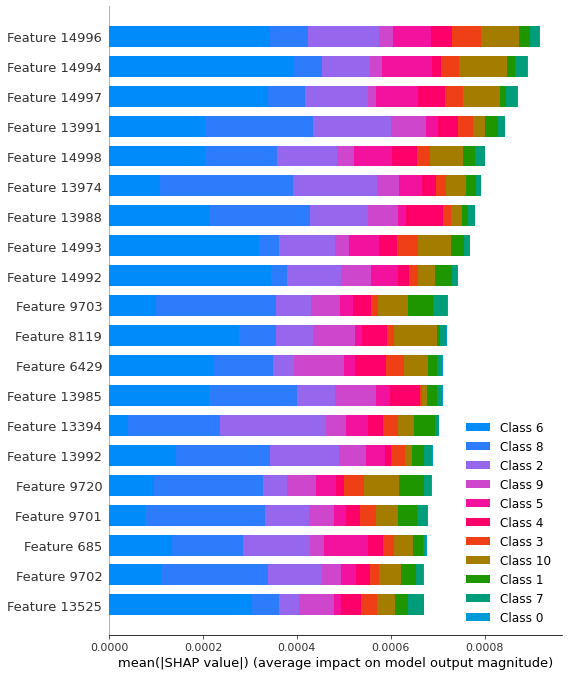

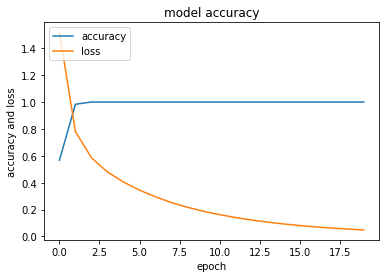

No positive samples in y_true, true positive value should be meaningless


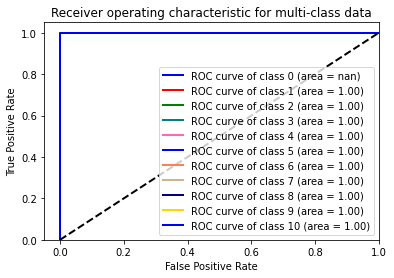

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [65]:
df_theta= createdataframeright("theta",2)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


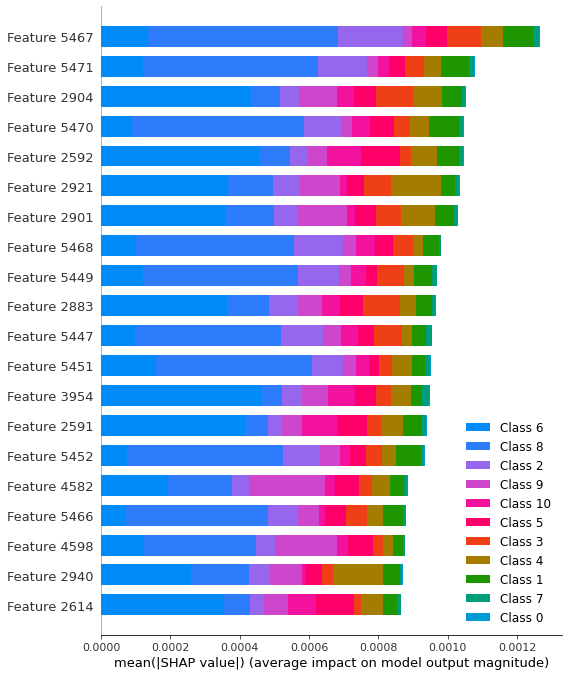

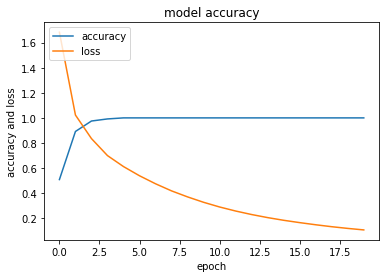

No positive samples in y_true, true positive value should be meaningless


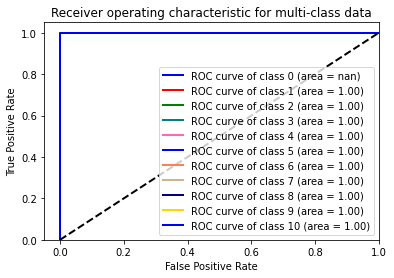

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [66]:
df_theta= createdataframeright("theta",3)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


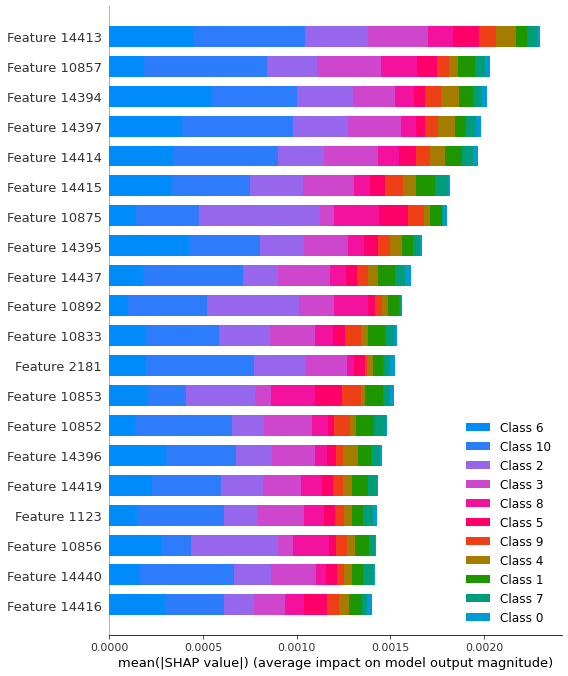

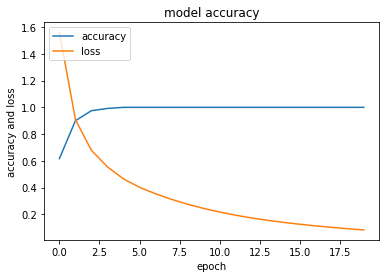

No positive samples in y_true, true positive value should be meaningless


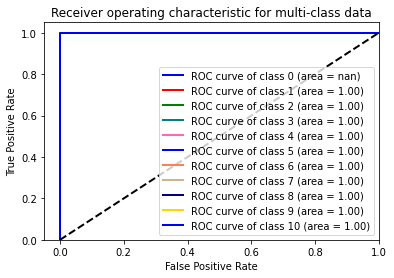

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 1 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 2 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  0.9666666666666667

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      0.75      0.86         4
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       0.67      1.00      0.80         2
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy               

In [67]:
df_theta= createdataframeright("theta",4)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

theta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


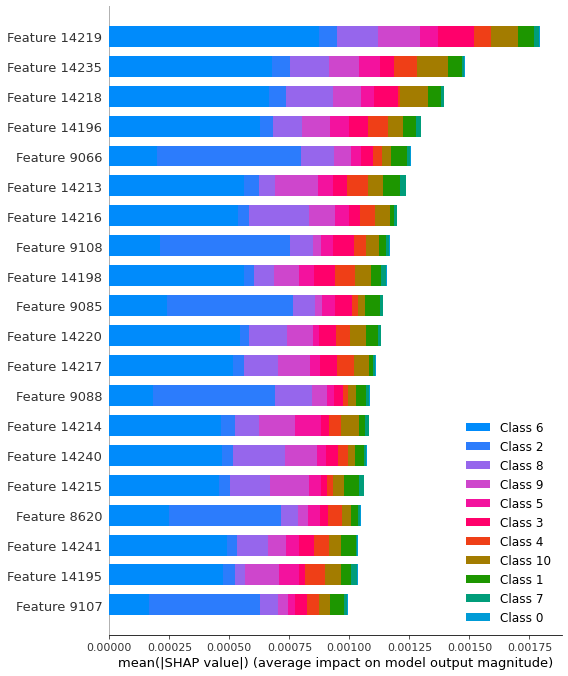

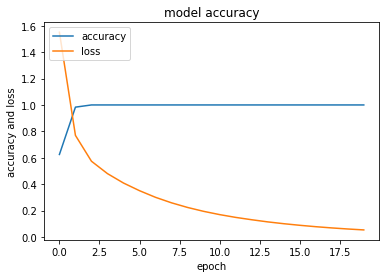

No positive samples in y_true, true positive value should be meaningless


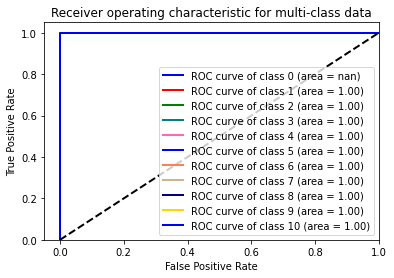

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [68]:
df_theta= createdataframeright("theta",5)
classification_report_theta = createmodel(df_theta)
print(classification_report_theta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


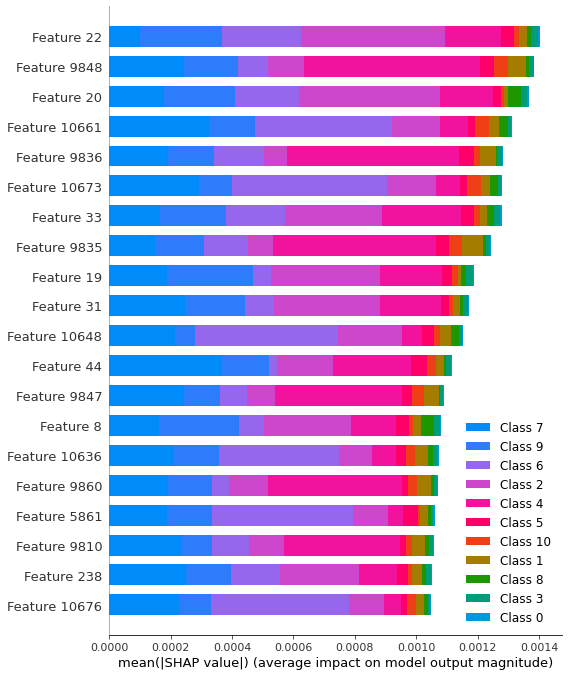

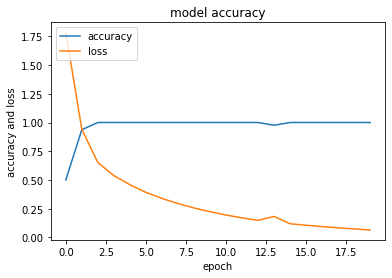

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


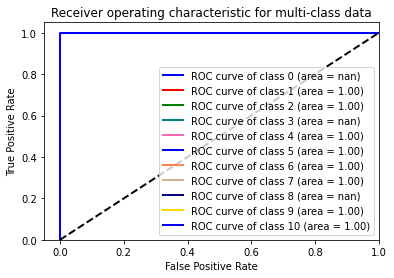

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [69]:
df_alpha= createdataframeleft("alpha",1)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


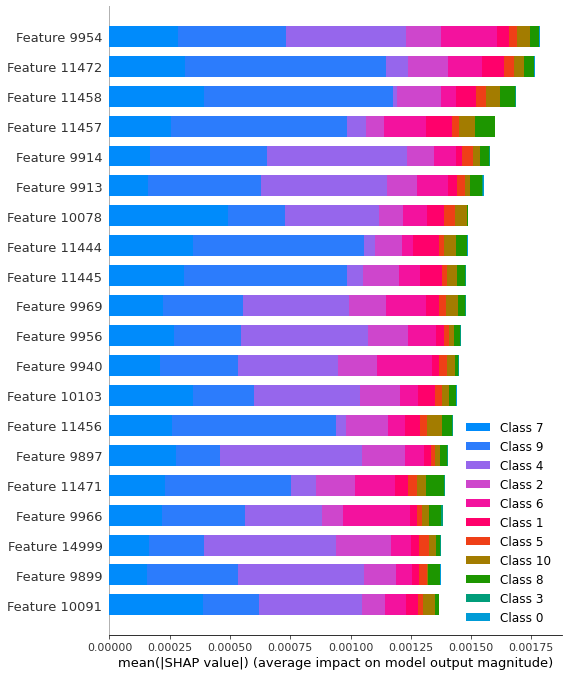

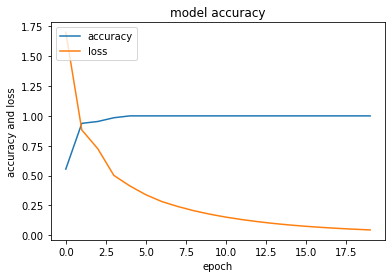

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


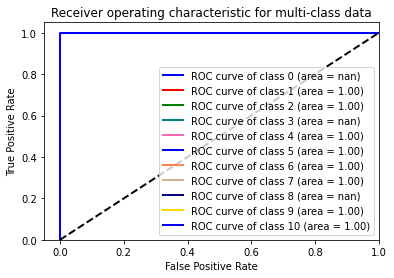

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [70]:
df_alpha= createdataframeleft("alpha",2)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


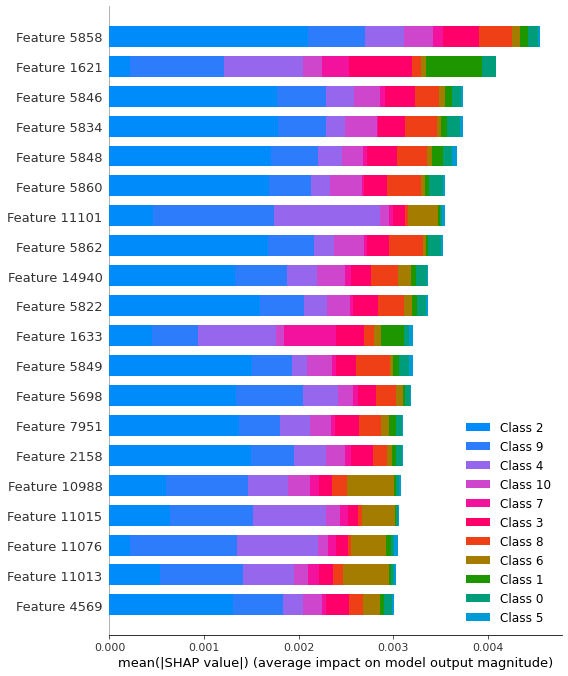

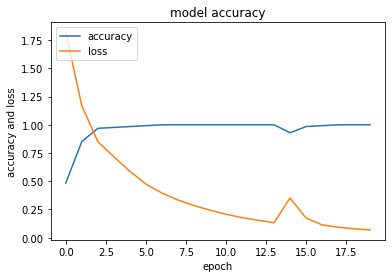

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


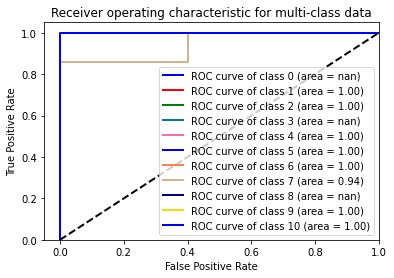

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0]
 [0 0 0 0 2 0 0 0 0]
 [0 0 0 0 0 6 0 0 0]
 [0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 0 2]]

accuracy score=  0.96875

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       0.86      1.00      0.92         6
           8       0.00      0.00      0.00         1
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.87      0.89      0.88        32
weighted avg       0.94      0.97  

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


In [71]:
df_alpha= createdataframeleft("alpha",3)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


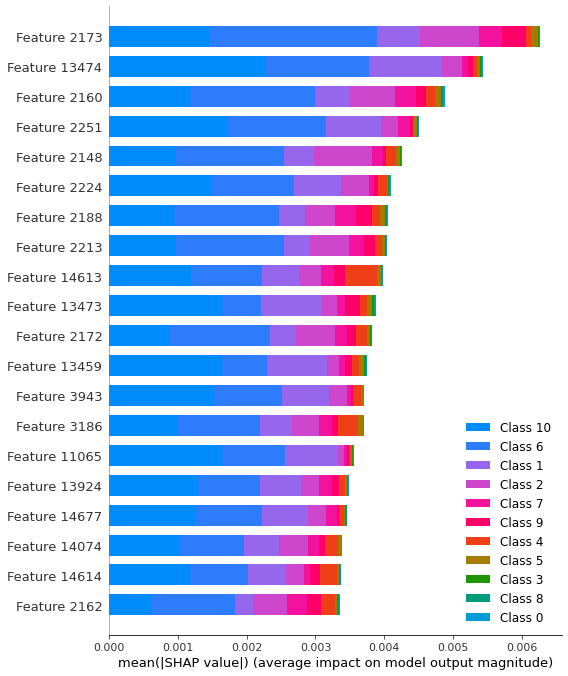

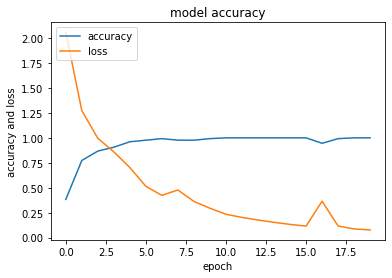

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


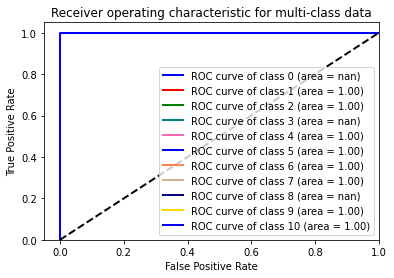

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [72]:
df_alpha= createdataframeleft("alpha",4)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


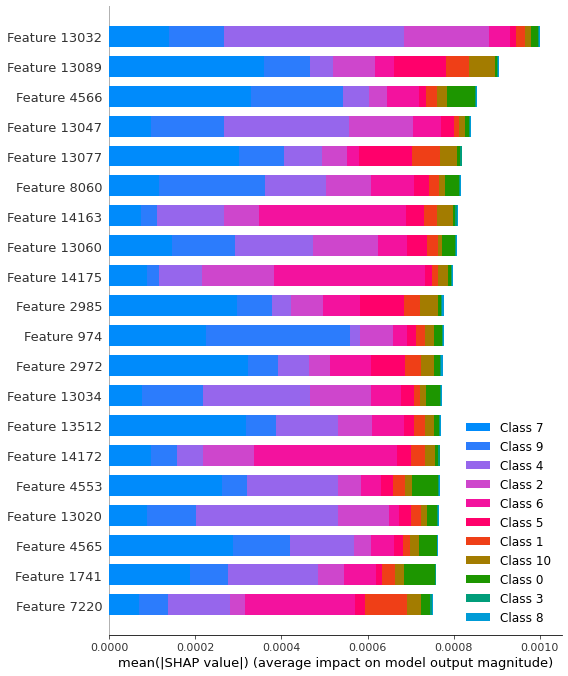

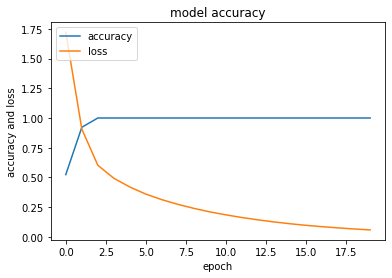

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


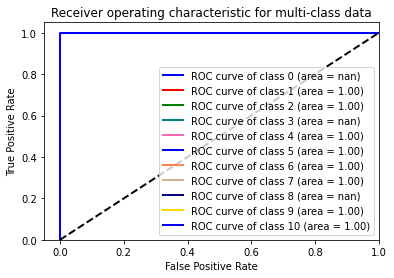

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [73]:
df_alpha= createdataframeleft("alpha",5)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


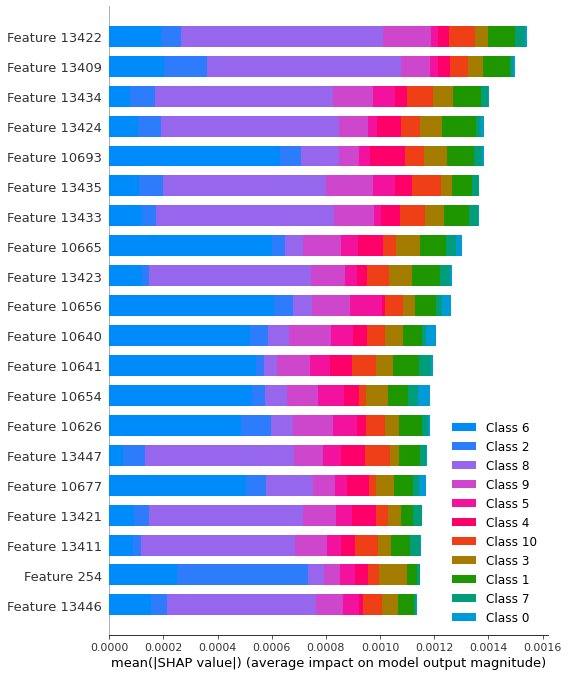

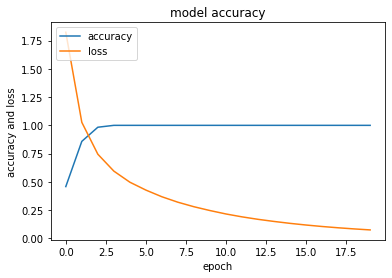

No positive samples in y_true, true positive value should be meaningless


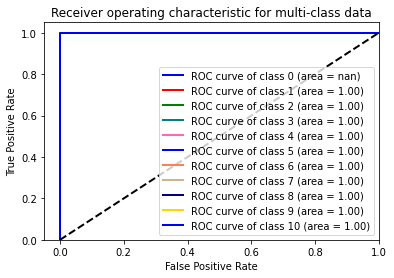

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [74]:
df_alpha= createdataframeright("alpha",1)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


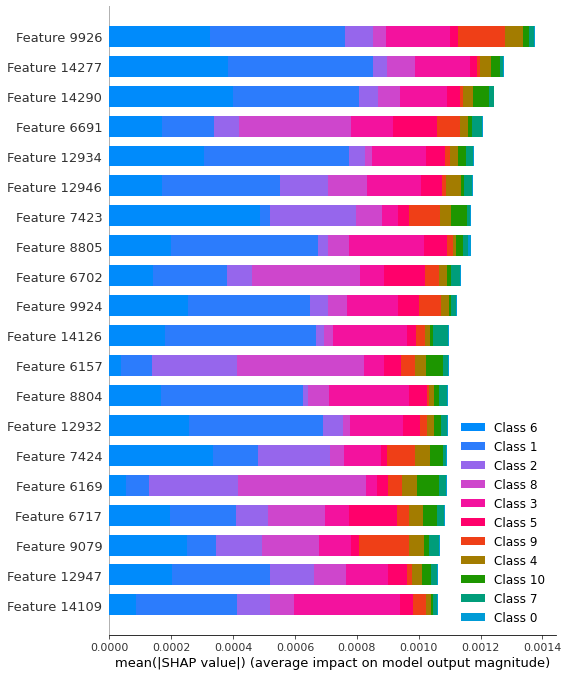

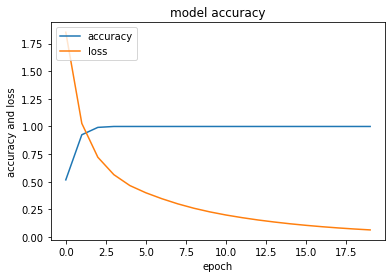

No positive samples in y_true, true positive value should be meaningless


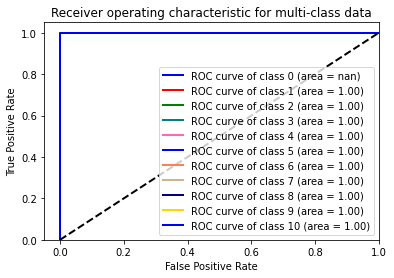

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [75]:
df_alpha= createdataframeright("alpha",2)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


keras is no longer supported, please use tf.keras instead.
Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


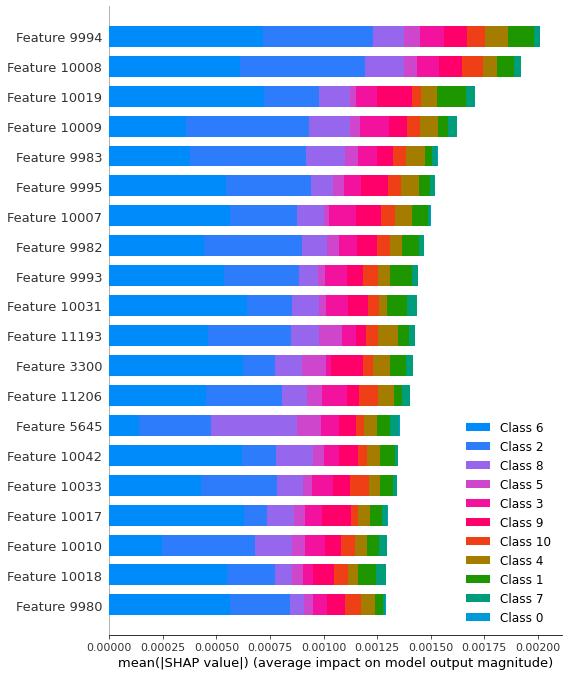

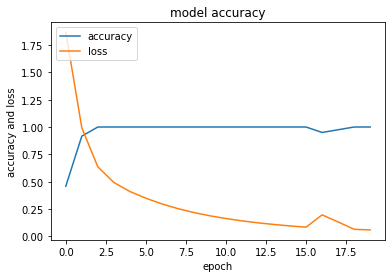

No positive samples in y_true, true positive value should be meaningless


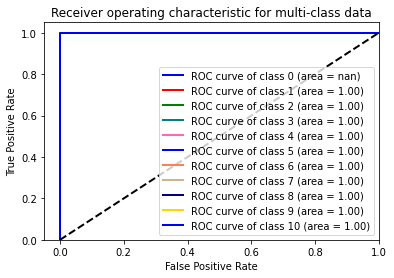

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [17]:
df_alpha= createdataframeright("alpha",3)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


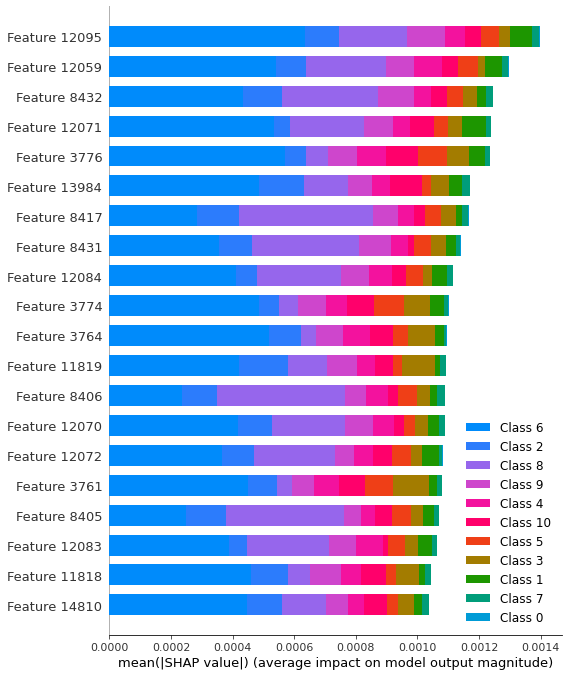

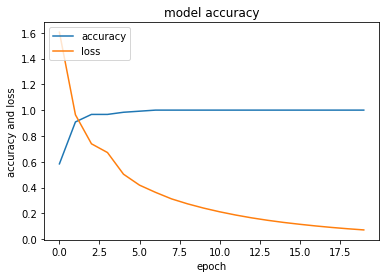

No positive samples in y_true, true positive value should be meaningless


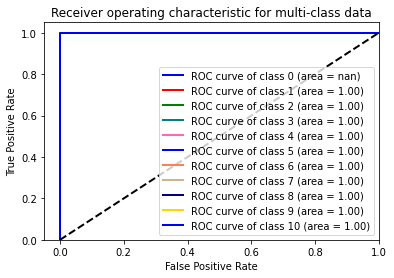

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [18]:
df_alpha= createdataframeright("alpha",4)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

alpha
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


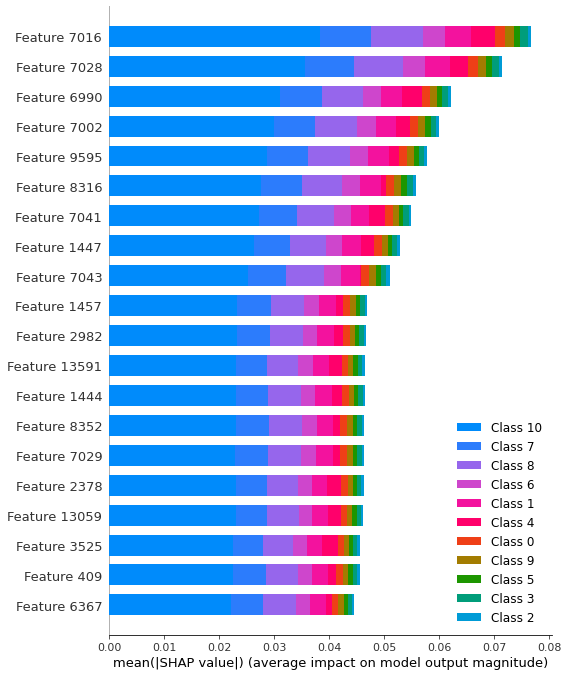

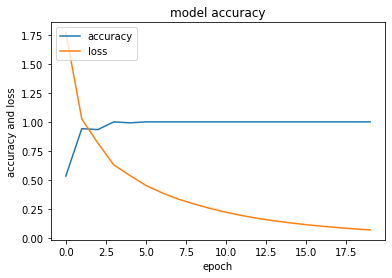

No positive samples in y_true, true positive value should be meaningless


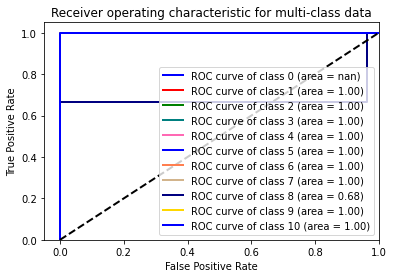

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 1 0 0]
 [0 0 0 0 0 0 0 2 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  0.9666666666666667

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      0.50      0.67         2
           8       0.67      1.00      0.80         2
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy               

In [19]:
df_alpha= createdataframeright("alpha",5)
classification_report_beta = createmodel(df_alpha)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


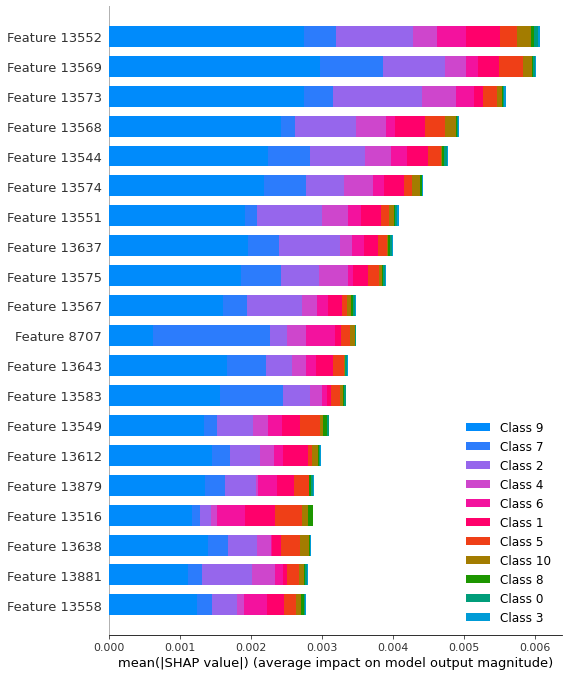

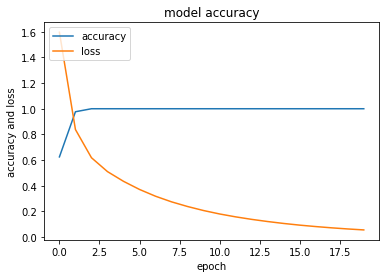

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


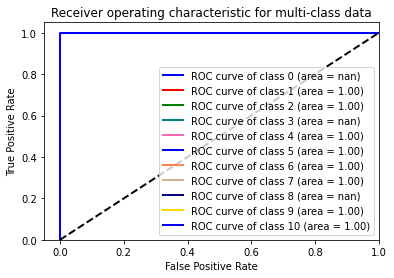

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [20]:
df_beta= createdataframeleft("beta",1)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


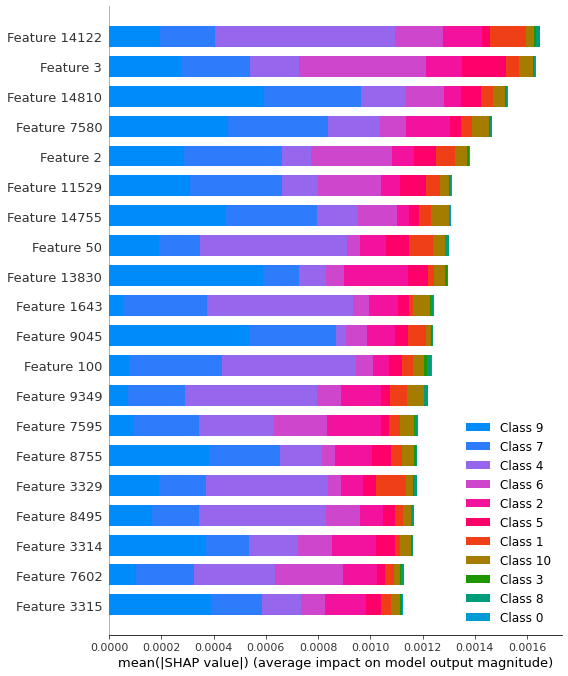

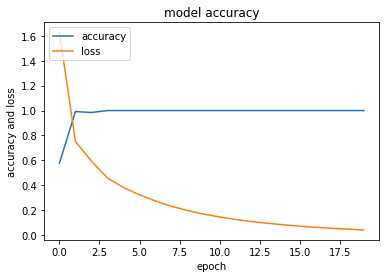

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


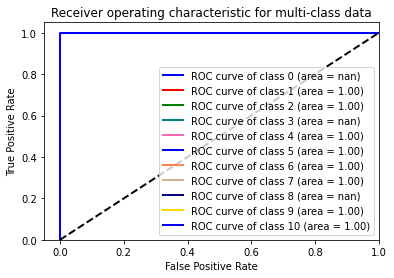

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [21]:
df_beta= createdataframeleft("beta",2)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


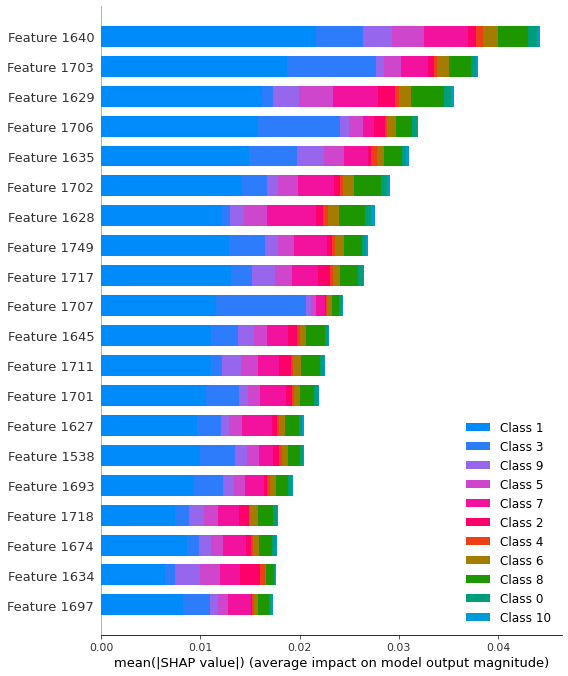

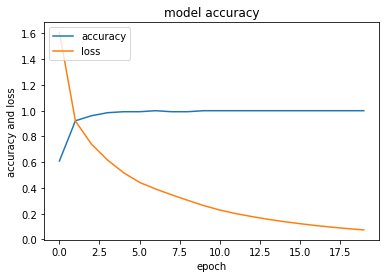

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


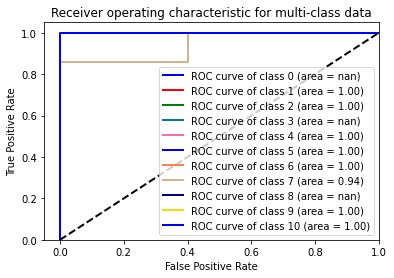

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 6 0 1]
 [0 0 0 0 0 1 5 0]
 [0 0 0 0 0 0 0 1]]

accuracy score=  0.9375

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       0.86      0.86      0.86         7
           9       1.00      0.83      0.91         6
          10       0.50      1.00      0.67         1

    accuracy                           0.94        32
   macro avg       0.92      0.96      0.93        32
weighted avg       0.95      0.94      0.94        32


    class  sensitivity  specificity
0    1.0     1.000000     1.000000


In [22]:
df_beta= createdataframeleft("beta",3)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


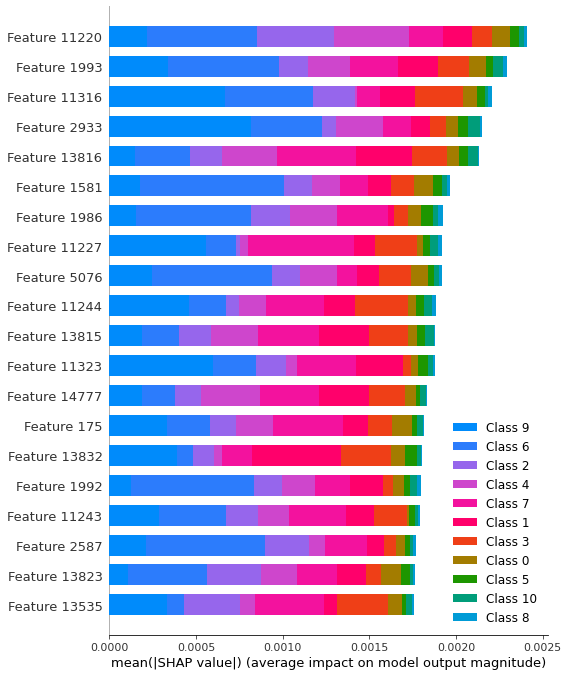

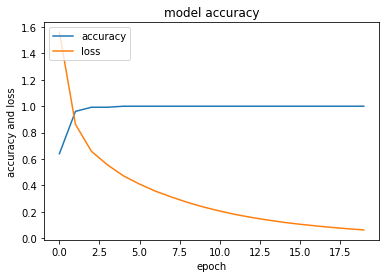

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


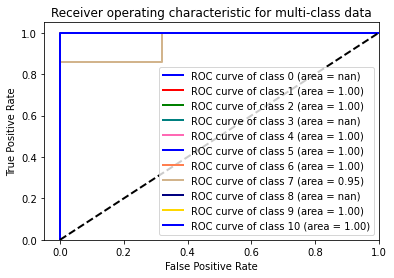

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 1 0 0]
 [0 0 0 3 0 0 0 0 0]
 [0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 2 0 0 0]
 [0 0 0 0 0 0 6 0 0]
 [0 0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 0 2]]

accuracy score=  0.96875

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           3       0.00      0.00      0.00         1
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       0.86      1.00      0.92         6
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.87      0.89      0.88        32
weighted avg       0.94      0.97  

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


In [23]:
df_beta= createdataframeleft("beta",4)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


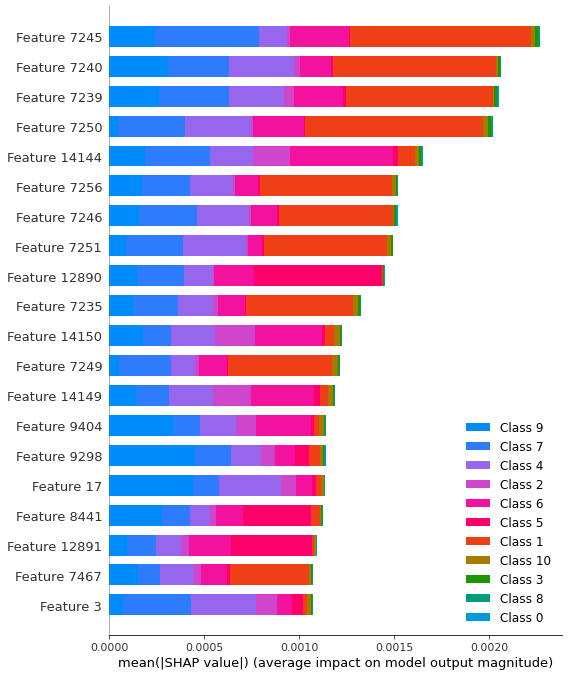

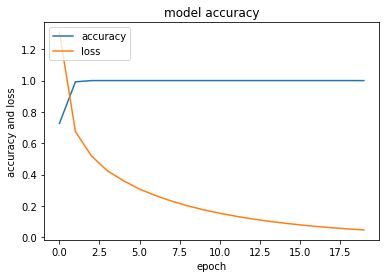

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


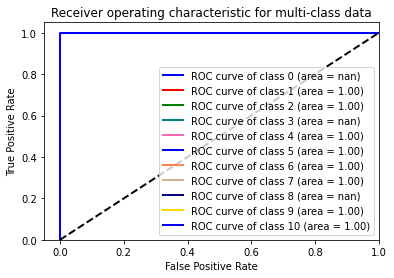

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [24]:
df_beta= createdataframeleft("beta",5)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


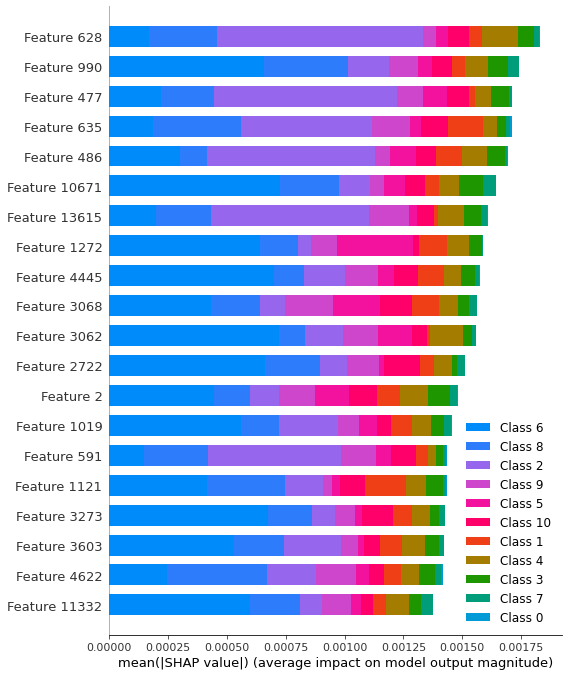

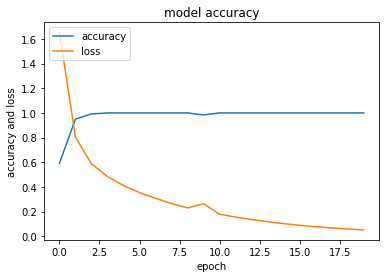

No positive samples in y_true, true positive value should be meaningless


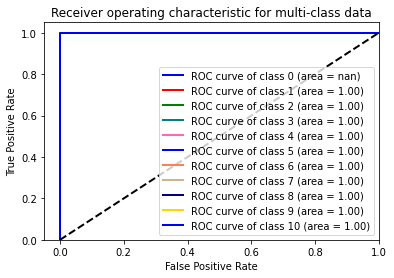

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [25]:
df_beta= createdataframeright("beta",1)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


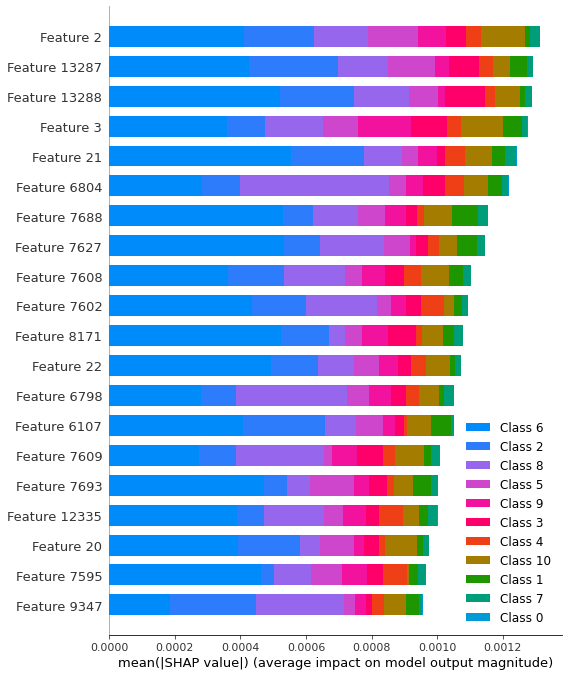

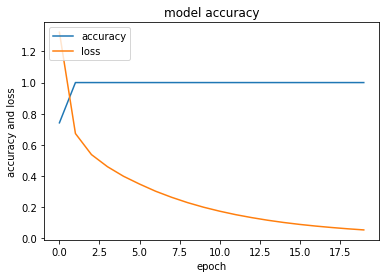

No positive samples in y_true, true positive value should be meaningless


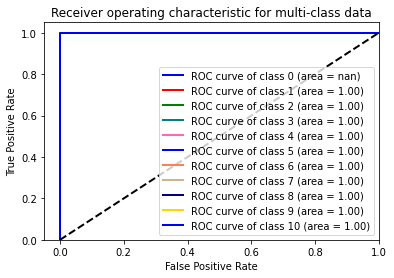

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [26]:
df_beta= createdataframeright("beta",2)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


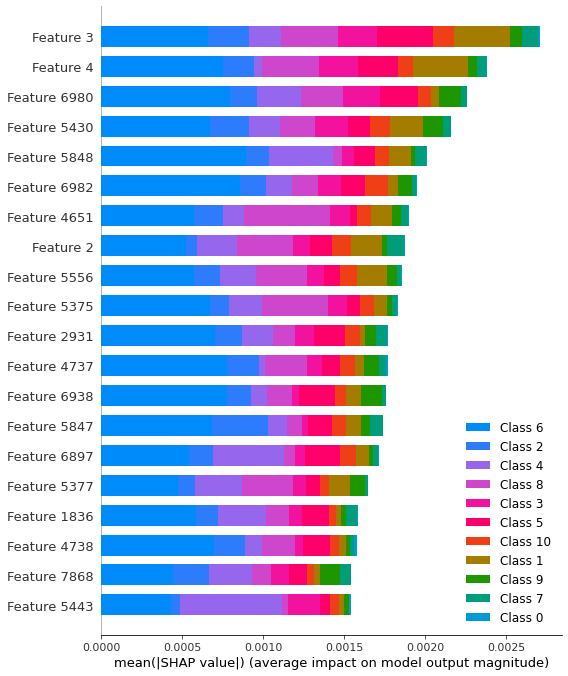

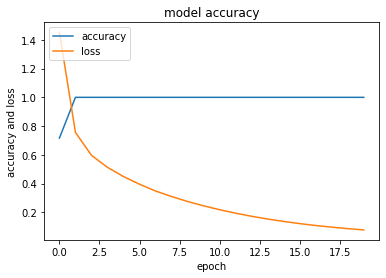

No positive samples in y_true, true positive value should be meaningless


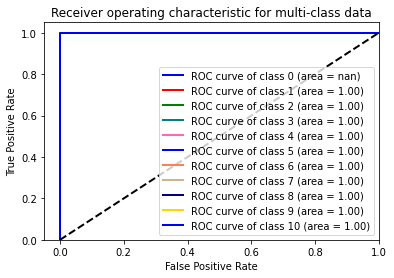

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 1 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  0.9666666666666667

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      0.75      0.86         4
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       0.75      1.00      0.86         3
          10       1.00      1.00      1.00         3

    accuracy               

In [27]:
df_beta= createdataframeright("beta",3)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


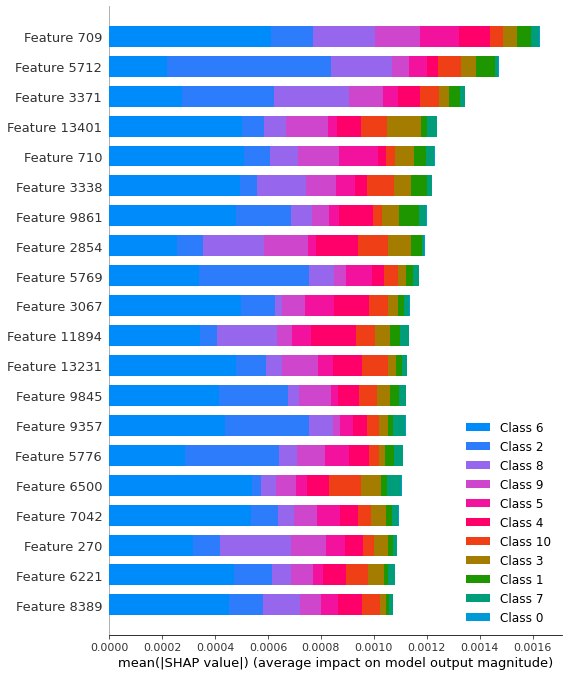

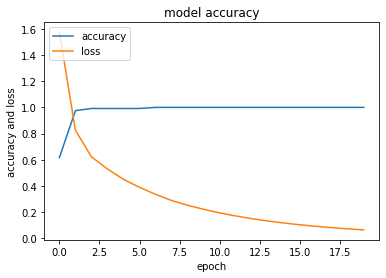

No positive samples in y_true, true positive value should be meaningless


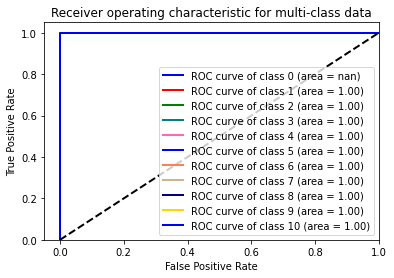

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 1 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 2 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  0.9666666666666667

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      0.75      0.86         4
           7       1.00      1.00      1.00         1
           8       0.67      1.00      0.80         2
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy               

In [28]:
df_beta= createdataframeright("beta",4)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

beta
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)            

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


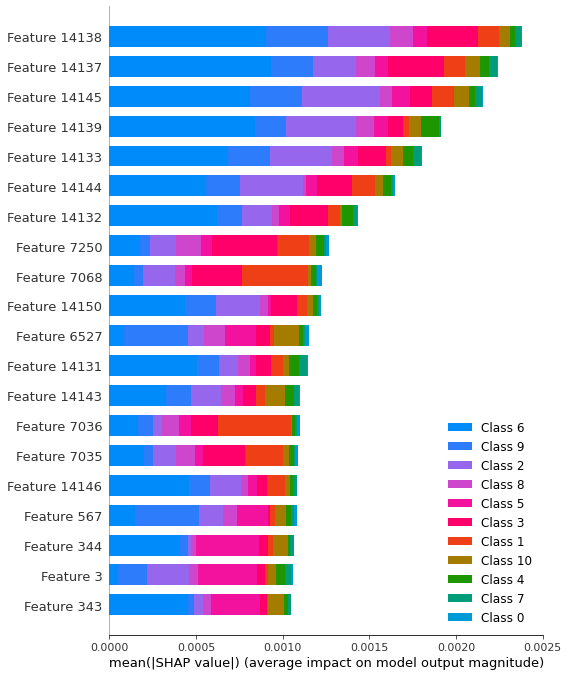

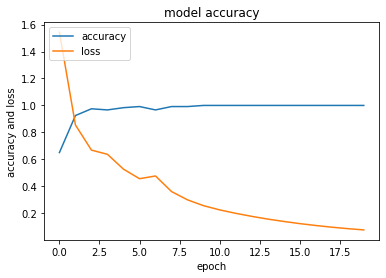

No positive samples in y_true, true positive value should be meaningless


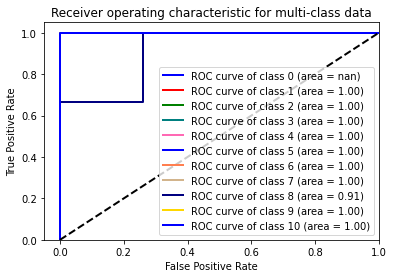

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 1 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 2 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  0.9666666666666667

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      0.75      0.86         4
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       0.67      1.00      0.80         2
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy               

In [29]:
df_beta= createdataframeright("beta",5)
classification_report_beta = createmodel(df_beta)
print(classification_report_beta)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


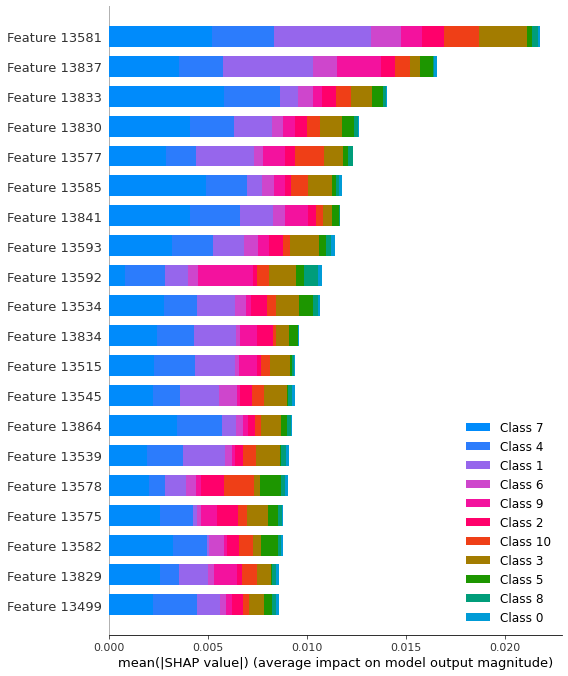

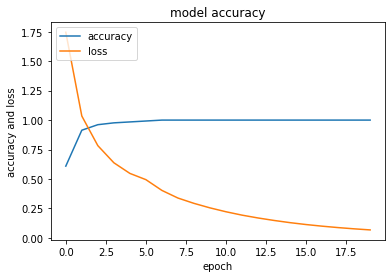

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


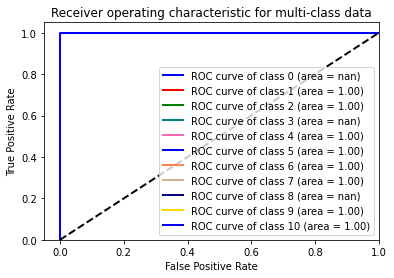

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 1 0]
 [0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  0.96875

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      0.88      0.93         8
           9       0.80      1.00      0.89         4
          10       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.97      0.98      0.98        32
weighted avg       0.97      0.97      0.97        32


    class  sensitivity  specificity
0    1.0         1.00          1.0

In [30]:
df_gamma= createdataframeleft("gamma",1)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


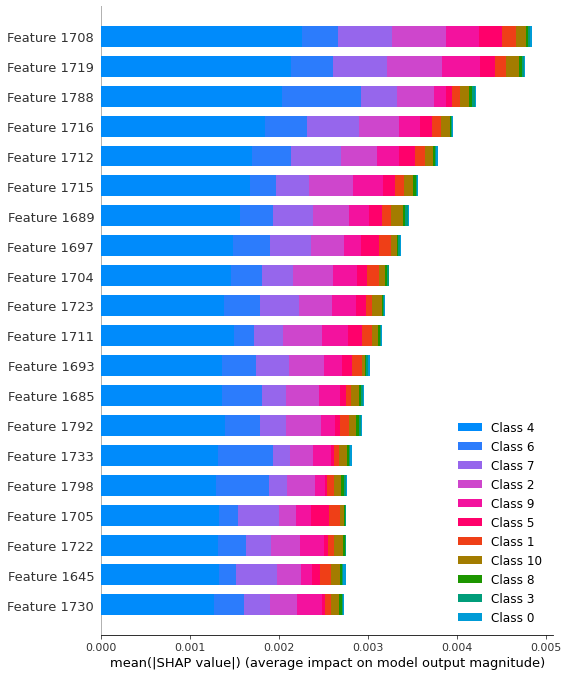

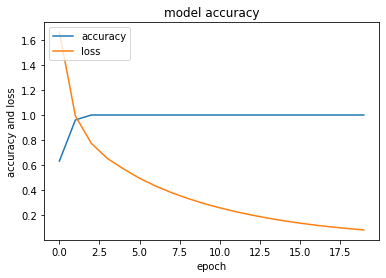

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


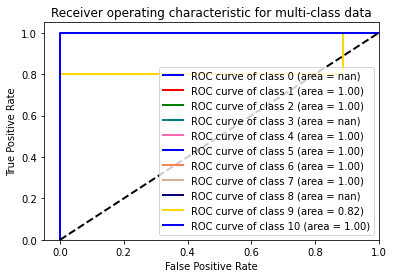

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 1 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  0.96875

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      0.75      0.86         4
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       0.80      1.00      0.89         4
          10       1.00      1.00      1.00         2

    accuracy                           0.97        32
   macro avg       0.97      0.97      0.97        32
weighted avg       0.97      0.97      0.97        32


    class  sensitivity  specificity
0    1.0     1.000000          1.0

In [31]:
df_gamma= createdataframeleft("gamma",2)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


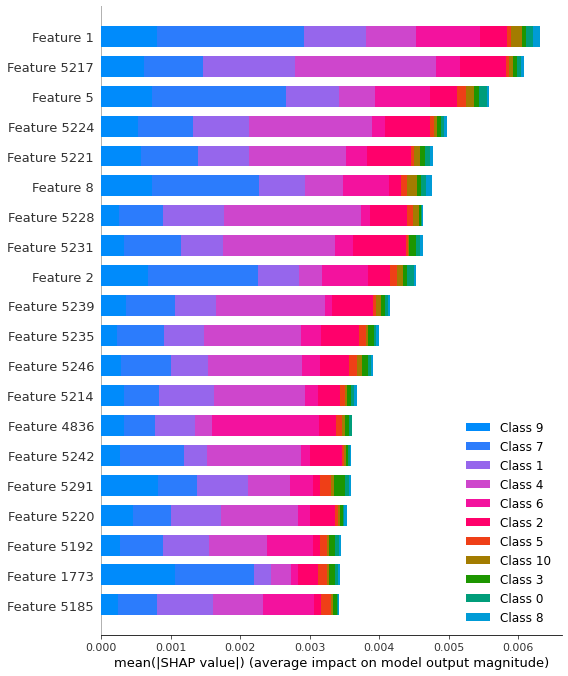

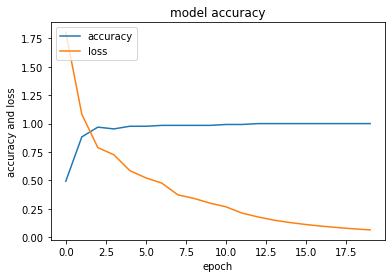

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


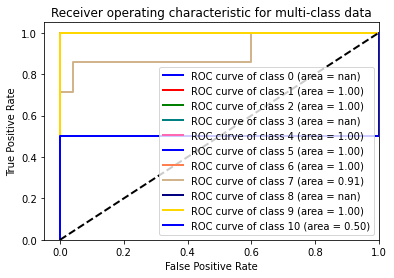

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 1 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 6 0 1]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 1]]

accuracy score=  0.9375

classification report

              precision    recall  f1-score   support

           1       1.00      0.75      0.86         4
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       0.86      0.86      0.86         7
           9       1.00      1.00      1.00         5
          10       0.50      1.00      0.67         1

    accuracy                           0.94        32
   macro avg       0.92      0.95      0.92        32
weighted avg       0.95      0.94      0.94        32


    class  sensitivity  specificity
0    1.0     0.965517     1.000000


In [32]:
df_gamma= createdataframeleft("gamma",3)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


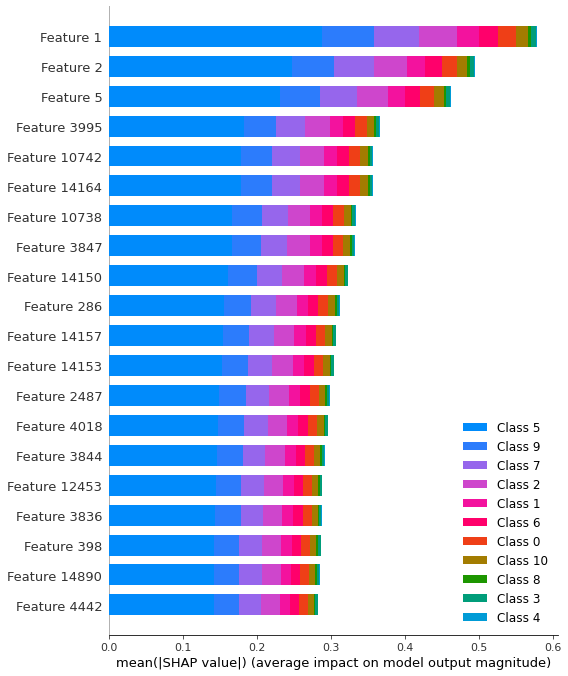

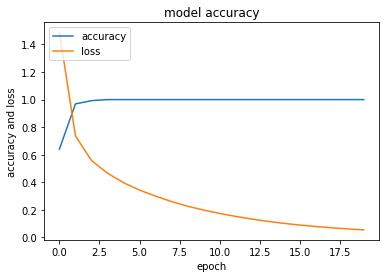

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


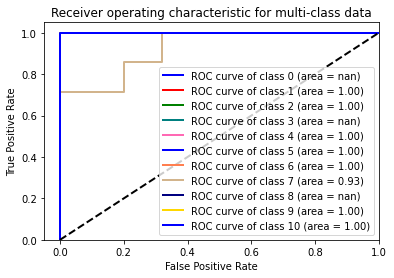

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 1 0 0]
 [0 5 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 1 0 3 0 0 0 0]
 [0 0 0 0 2 1 0 0]
 [0 1 0 0 0 5 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  0.875

classification report

              precision    recall  f1-score   support

           1       1.00      0.75      0.86         4
           2       0.71      1.00      0.83         5
           4       1.00      1.00      1.00         3
           5       1.00      0.75      0.86         4
           6       1.00      0.67      0.80         3
           7       0.71      0.83      0.77         6
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           0.88        32
   macro avg       0.93      0.88      0.89        32
weighted avg       0.90      0.88      0.88        32


    class  sensitivity  specificity
0    1.0     0.965517     1.000000
1

In [33]:
df_gamma= createdataframeleft("gamma",4)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


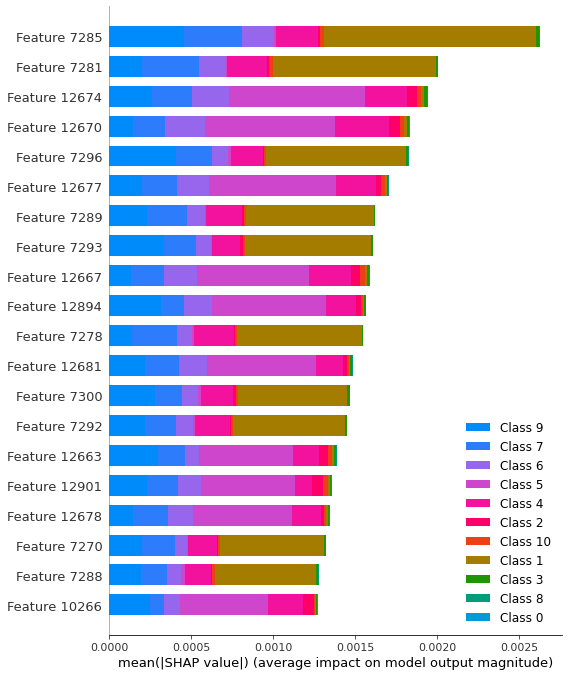

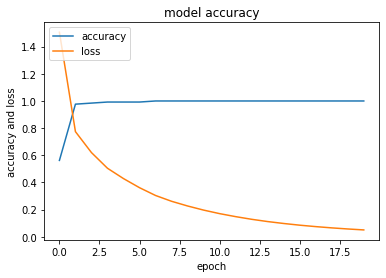

No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless
No positive samples in y_true, true positive value should be meaningless


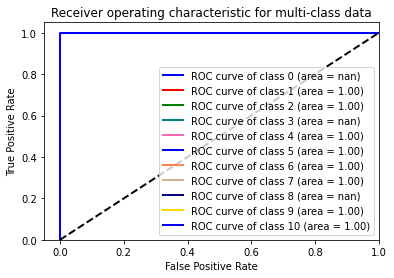

Current level{1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 9.0, 10.0}
confusion matrix 

 [[3 0 0 0 0 0 0 0]
 [0 7 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0]
 [0 0 0 3 0 0 0 0]
 [0 0 0 0 2 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 0 0 0 0 5 0]
 [0 0 0 0 0 0 0 2]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         7
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         5
          10       1.00      1.00      1.00         2

    accuracy                           1.00        32
   macro avg       1.00      1.00      1.00        32
weighted avg       1.00      1.00      1.00        32


    class  sensitivity  specificity
0    1.0          1.0          1.0
1  

In [34]:
df_gamma= createdataframeleft("gamma",5)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


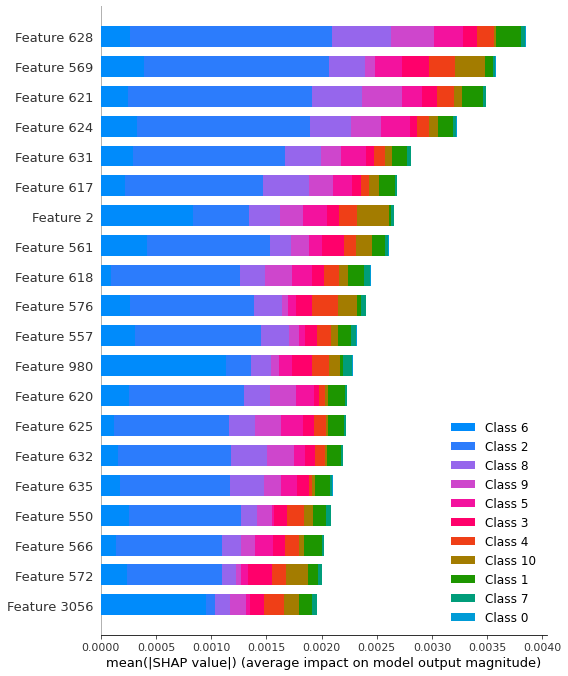

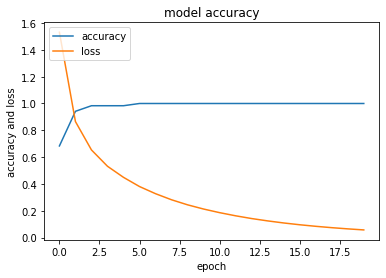

No positive samples in y_true, true positive value should be meaningless


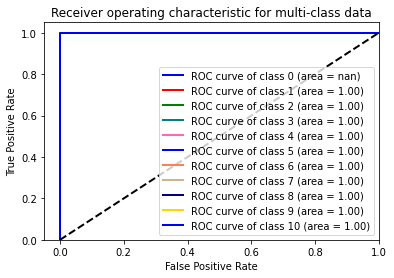

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[2 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 4 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  1.0

classification report

              precision    recall  f1-score   support

           1       1.00      1.00      1.00         2
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         4
          10       1.00      1.00      1.00         3

    accuracy                           1.0

In [35]:
df_gamma= createdataframeright("gamma",1)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


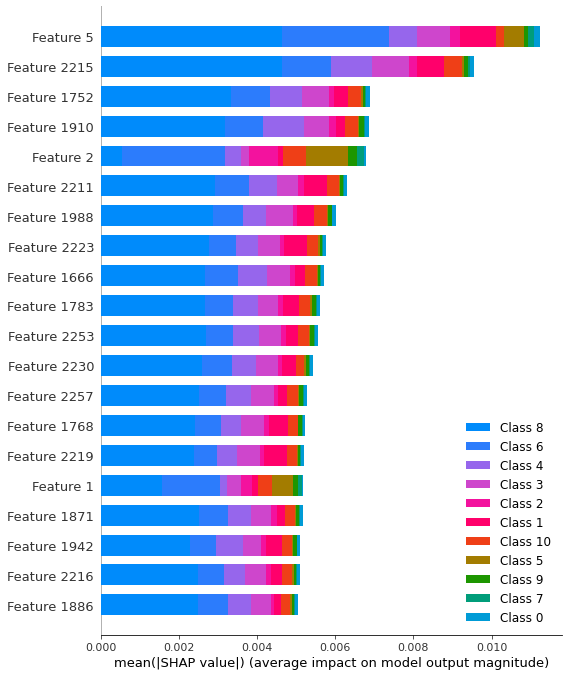

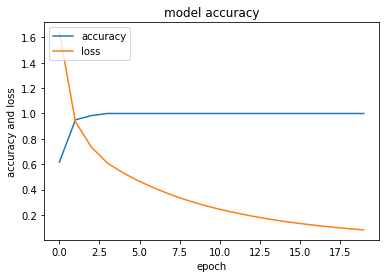

No positive samples in y_true, true positive value should be meaningless


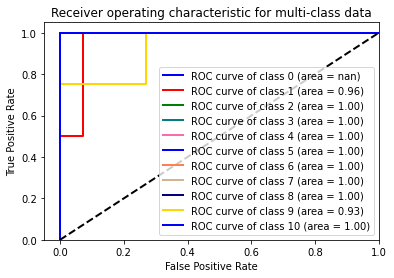

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[1 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 1 0]
 [0 0 0 0 0 0 1 0 0 0]
 [1 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 3]]

accuracy score=  0.9333333333333333

classification report

              precision    recall  f1-score   support

           1       0.50      1.00      0.67         1
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      0.75      0.86         4
           7       1.00      1.00      1.00         1
           8       1.00      0.75      0.86         4
           9       0.75      1.00      0.86         3
          10       1.00      1.00      1.00         3

    accuracy               

In [36]:
df_gamma= createdataframeright("gamma",2)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


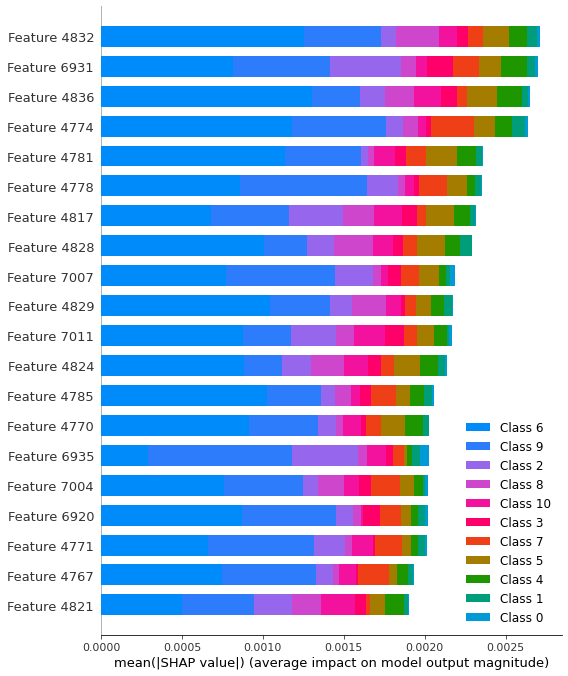

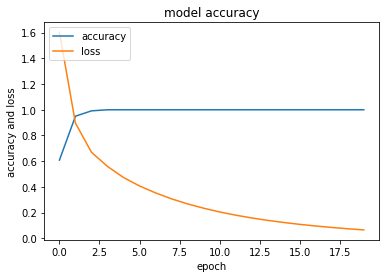

No positive samples in y_true, true positive value should be meaningless


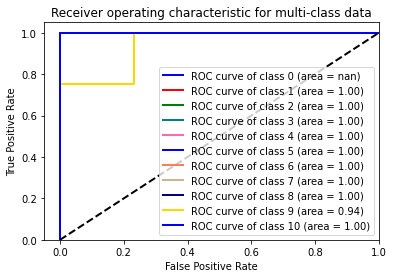

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[1 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 1 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [1 0 0 0 0 0 0 0 0 3]]

accuracy score=  0.9333333333333333

classification report

              precision    recall  f1-score   support

           1       0.50      1.00      0.67         1
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      0.50      0.67         2
           8       1.00      1.00      1.00         3
           9       0.75      1.00      0.86         3
          10       1.00      0.75      0.86         4

    accuracy               

In [37]:
df_gamma= createdataframeright("gamma",3)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


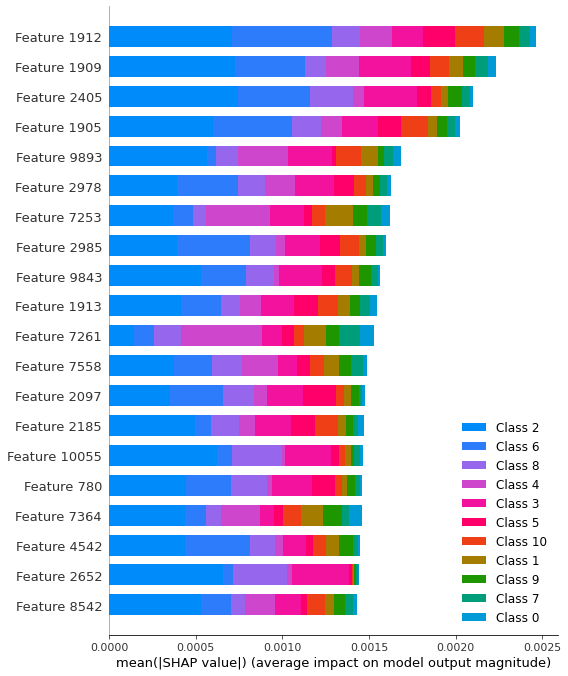

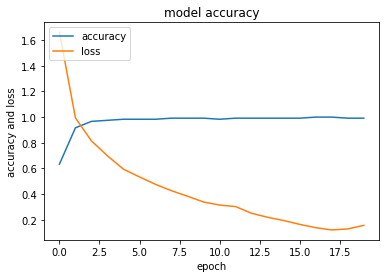

No positive samples in y_true, true positive value should be meaningless


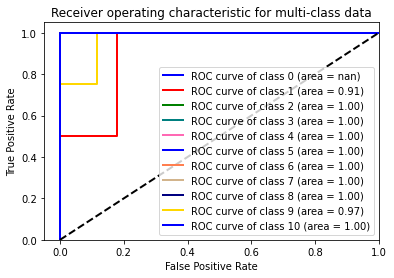

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[0 0 1 0 0 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0 0]
 [0 0 0 0 3 0 0 0 0 0 0]
 [0 1 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 1 3]]

accuracy score=  0.9

classification report

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       0.50      1.00      0.67         1
           2       0.75      1.00      0.86         3
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      0.80      0.89         5
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       0.75      1.00      0.86         

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


In [38]:
df_gamma= createdataframeright("gamma",4)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)

gamma
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2500)              37502500  
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              2501000   
_________________________________________________________________
dense_2 (Dense)              (None, 500)               500500    
_________________________________________________________________
dense_3 (Dense)              (None, 200)               100200    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               20100     
_________________________________________________________________
dense_5 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_6 (Dense)              (None, 25)           

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


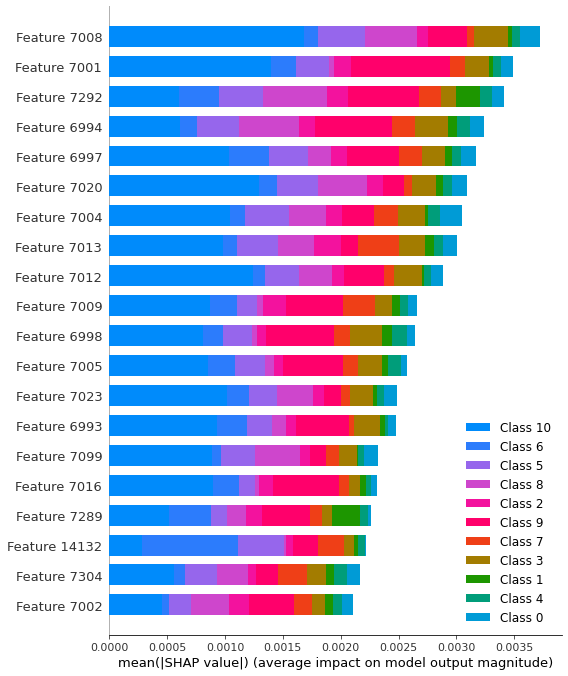

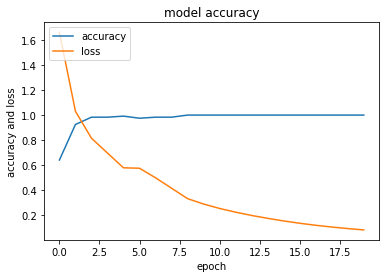

No positive samples in y_true, true positive value should be meaningless


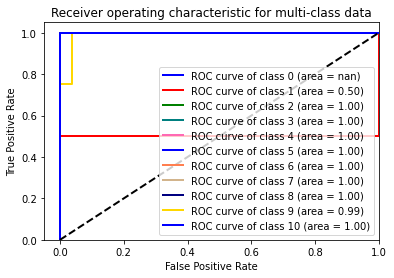

Current level{1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0}
confusion matrix 

 [[1 0 0 0 0 0 0 0 0 0]
 [0 4 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0]
 [0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 4 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 0 3 0 0]
 [0 0 0 0 0 0 0 0 3 0]
 [1 0 0 0 0 0 0 0 1 3]]

accuracy score=  0.9333333333333333

classification report

              precision    recall  f1-score   support

           1       0.50      1.00      0.67         1
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         4
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         3
           9       0.75      1.00      0.86         3
          10       1.00      0.60      0.75         5

    accuracy               

In [39]:
df_gamma= createdataframeright("gamma",5)
classification_report_gamma = createmodel(df_gamma)
print(classification_report_gamma)